In [6]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [10]:
import numpy as np
import pylab as plt
import glob
import os
from pprint import pprint
import scipy.integrate as inte
import scipy.special as special
import scipy.interpolate as interp
import scipy.signal as sig

import icewave.field.time as timest


Linux
oural


In [11]:
import stephane.display.graphes as graphes
import stephane.tools.Smath as smath

import icewave.tools.datafolders as df
import icewave.tools.rw_data as rw
import icewave.phone.analyse as analyse


#import sympy #symoblic python
#import mpmath as math
#import cv2
import glob
import csv
import os

import icewave.field.multi_instruments as multi

import phonefleet.connect as connect
import phonefleet.data as dataphone

import icewave.phone.pipeline as pl


/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/
Please install garmin package


In [12]:
date = '0211'
phonelist = pl.get_phonelist(date)

/media/turbots/BlueDisk/Shack25_local/Data/
Found 30 phone folders : 
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 28, 17, 25, 26, 27, 31, 32, 35, 18, 19, 21, 22, 23, 24]


In [13]:
files = pl.get_filelist(date)

/media/turbots/BlueDisk/Shack25_local/Data/
Found 30 phone folders : 
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 28, 17, 25, 26, 27, 31, 32, 35, 18, 19, 21, 22, 23, 24]
/media/turbots/BlueDisk/Shack25_local/Data/


In [14]:
r = pl.load_lvl_0(files,1,5)

In [15]:
files[1]['gps'][1]

'/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/1/-2025-02-11T11_32_28-gps-1-336452087620-337352096202.csv'

/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/1/2025_02_11_L1_phone1_num5.h5


In [17]:
hf['phone'][()]

1

In [106]:
r['num']

5

In [107]:
hf.keys()

<KeysViewHDF5 ['GPS_time', 'ax', 'ay', 'az', 'complete', 'coords', 'date', 'filename', 'folder', 'gpselev', 'gpslat', 'gpslon', 'gx', 'gy', 'gz', 'mx', 'my', 'mz', 'num', 'oural_time', 'phone', 'position_GPS', 'position_Garmin', 't_sync', 'ta', 'tg', 'tgps', 'tm']>

In [122]:
hf['ta'][:10]/3600/24

array([5.21041751, 5.21041753, 5.21041756, 5.21041759, 5.21041762,
       5.21041765, 5.21041768, 5.21041771, 5.21041773, 5.21041776])

In [126]:
tmin = hf['t_sync'][0]
tmax = hf['t_sync'][-1]

print(timest.display_time(timest.today_time([tmin,tmax])))

['13:30:54', '13:45:41']


In [125]:
print(timest.display_time([]))

['483138:30:54']


In [136]:
savefolder = pl.get_savefolder(date)
print(savefolder)

/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/Results/


In [36]:
import icewave.phone.sismo as sismo


In [37]:
folder = sismo.summary_folder(date)
filename = folder+'Phone_Table.txt'

data = rw.read_csv(filename,delimiter='\t')
dic = rw.csv2dict(data)


/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/


In [43]:
print(dic.keys())
print(dic['phonelist'][0].split(','))

dict_keys(['tag', 'tstart', 'tend', 'phonelist', 'nums', 'orientation'])
['[1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16]']


In [48]:
data,tmin,tmax = sismo.from_N1_to_S2(date)
print(data.keys())

/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/
Load data N1 for phone 1
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/1/2025_02_11_L1_phone1_num9.h5
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/1/2025_02_11_L1_phone1_num10.h5
Load data N1 for phone 2
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/2/2025_02_11_L1_phone2_num9.h5
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/2/2025_02_11_L1_phone2_num10.h5
Load data N1 for phone 3
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/3/2025_02_11_L1_phone3_num9.h5
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/3/2025_02_11_L1_phone3_num10.h5
Load data N1 for phone 4
/media/turbots/BlueDisk/Shack25_loc

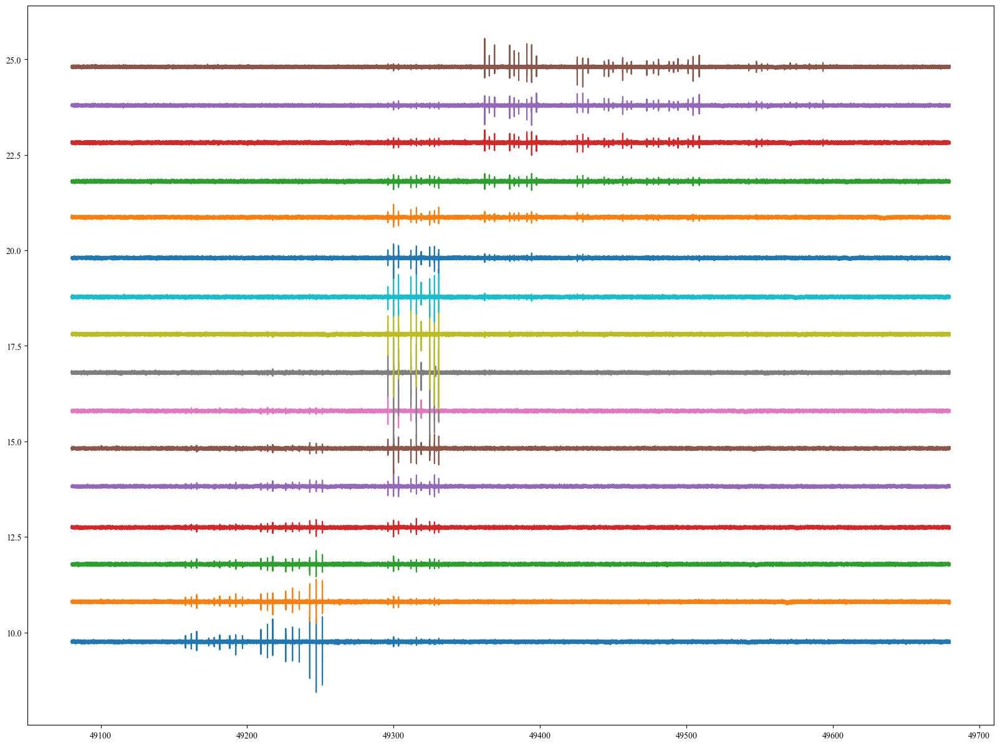

In [58]:
fig,ax = plt.subplots(figsize=(20,15))
for i,phone in enumerate(data.keys()):
    plt.plot(data[phone]['ts'],data[phone]['a_Z']+i)

/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/


In [32]:
print(dic.keys())
print(dic['tstart'][0])
print(dic['tend'][0])
print(dic['tag'][0])

dict_keys(['tag', 'tstart', 'tend', 'phonelist', 'nums'])
13:38:00
13:48:00
sismo_active


/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/1/2025_02_11_L1_phone1_num9.h5
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/1/2025_02_11_L1_phone1_num10.h5
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/2/2025_02_11_L1_phone2_num9.h5
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/2/2025_02_11_L1_phone2_num10.h5
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/3/2025_02_11_L1_phone3_num9.h5
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/3/2025_02_11_L1_phone3_num10.h5
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/4/2025_02_11_L1_phone4_num9.h5
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/0211/Ph

NameError: name 'savefolder' is not defined

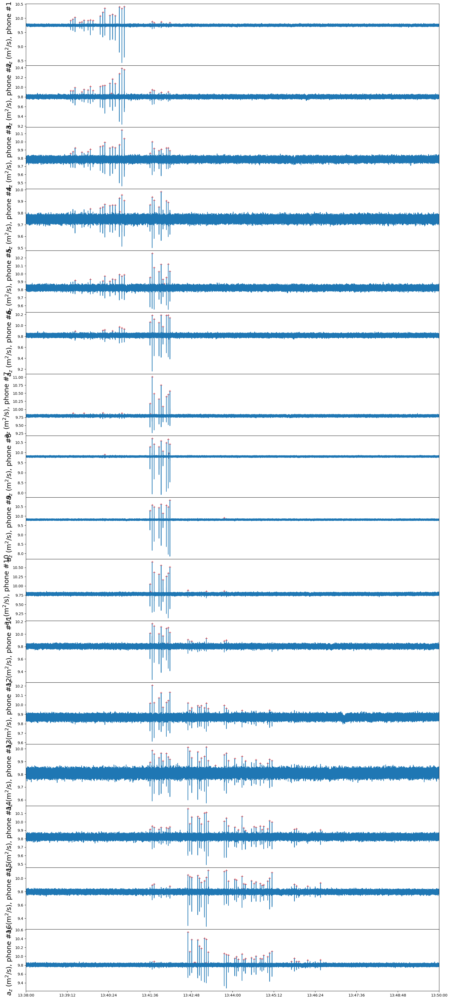

In [20]:
import icewave

phonelist = range(1,17)
n = len(phonelist)
num = 9

coord = 'z'
fig,axs = plt.subplots(figsize=(20,3*n),nrows=n,sharex=True)
 
nums = [9,10]
for phone,ax in zip(phonelist,axs):
    ts = []
    azs = []
    for num in nums:
        hf = pl.load_lvl_1(date,phone,num)
        t = list(hf['t_sync'])
        t = timest.today_time(t)
        ts = ts+t
        azs = azs+list(hf['a'+coord])

    ts = np.asarray(ts)
    azs = np.asarray(azs)

    tmin = multi.convert_time('13:38:00')
    tmax = multi.convert_time('13:48:00')

    indices = np.logical_and(ts>=tmin,ts<tmax)
    ts = ts[indices]
    azs = np.asarray(azs)[indices]

    
    peaks,props = sig.find_peaks(azs, prominence=0.15,distance=200)
    
    ax.plot(ts[peaks],azs[peaks],'r+')                
    ax.plot(ts,azs)
    
    plt.xlim([tmin,tmax])
    ticks = np.linspace(tmin,tmax,11)
    ax.set_xticks(ticks,timest.display_time(ticks))    

    
    graphes.legende('',f'$a_{coord}$ (m$^2$/s), phone #{phone}','',ax=ax)

fig.subplots_adjust(hspace=0)

print(savefolder)
figs = graphes.legende('$t$ (local time)',f'$a_{coord}$ (m$^2$/s), phone #{phone}','',ax=ax)

print(figs)

graphes.save_figs(figs,savedir=savefolder,prefix='Sismo_phones_1_16_',overwrite=True)



In [144]:
figs.keys()

dict_keys([1])

In [9]:
files.keys()

dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 28, 17, 25, 26, 27, 31, 32, 35, 18, 19, 21, 22, 23, 24])

In [22]:
r = pl.load_lvl_0(files,1,15)

In [24]:
pl.find_relevant_map(r)

Box dimension :True


'haha'

Extent((0.30873011549201174,0.34622910305645443)->(0.3087501956190994,0.3462491831835421) projected as normal)


(<Axes: xlabel='Longitude', ylabel='Latitude'>,
 {1: {'fignum': '', 'data': {}}})

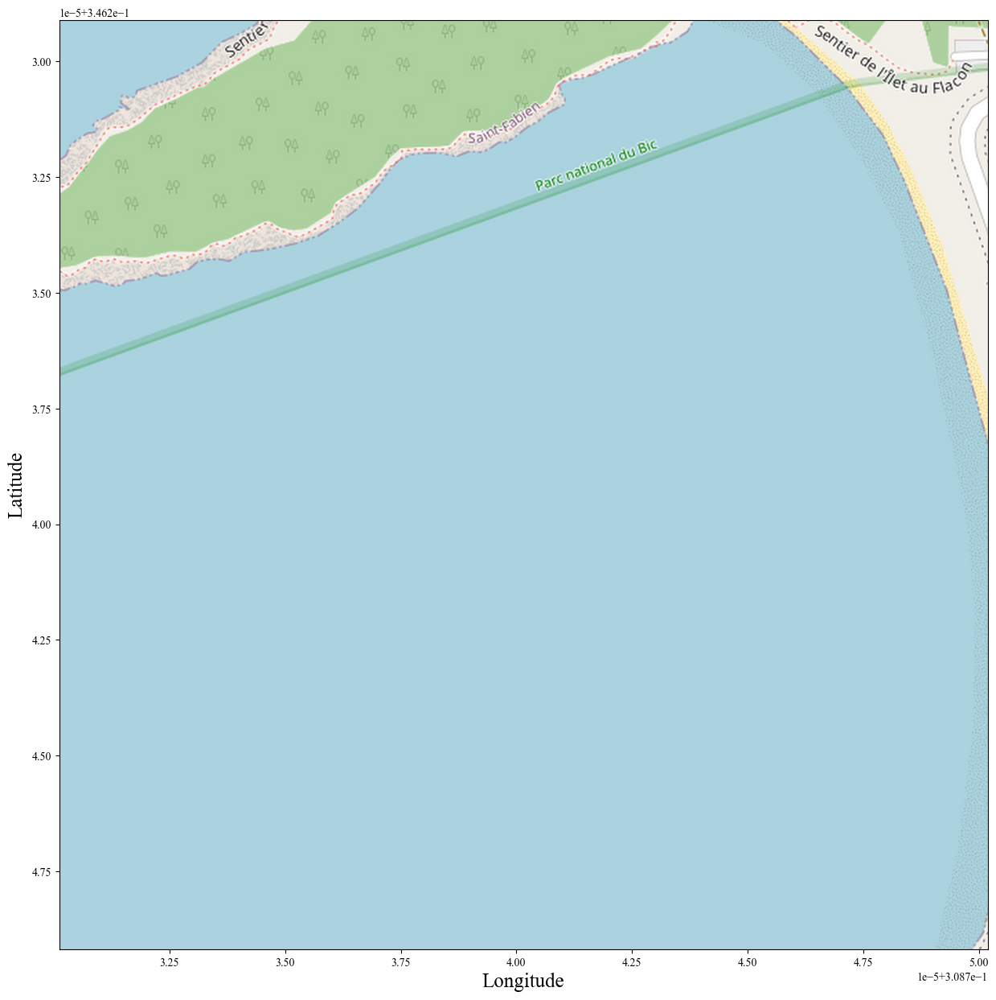

In [50]:
import icewave.gps.gps as gps
fig,ax = plt.subplots(figsize=(15,15))
gps.display_mercier(ax,title='')

please specify the folder path
Found 51 phone folders : 
[1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 26, 28, 29, 31, 32, 33, 34, 35, 36, 37, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 51, 52, 53, 54, 55, 27, 50, 58]
please specify the folder path
please specify the folder path
Median number of files : 38
No data for phone 10, num 37
No data for phone 32, num 34
No data for phone 32, num 35
No data for phone 32, num 36
No data for phone 32, num 37
No data for phone 33, num 33
No data for phone 33, num 34
No data for phone 33, num 35
No data for phone 33, num 36
No data for phone 33, num 37
No data for phone 35, num 37
No data for phone 40, num 36
No data for phone 40, num 37
No data for phone 42, num 20
No data for phone 42, num 21
No data for phone 42, num 22
No data for phone 42, num 23
No data for phone 42, num 24
No data for phone 42, num 25
No data for phone 42, num 26
No data for phone 42, num 27
No data for phone 42, num 28
No data for phone 

/home/turbots/Documents/git/icewave/icewave/phone/pipeline.py:216: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  sc = ax.pcolormesh(Indices,Phones,moving,cmap=cmap)


Box dimension :True
Extent((0.3088025,0.34614708390131765)->(0.3088902777777778,0.3461909727902065) projected as normal)
No data for phone 42, num 24
No data for phone 50, num 24


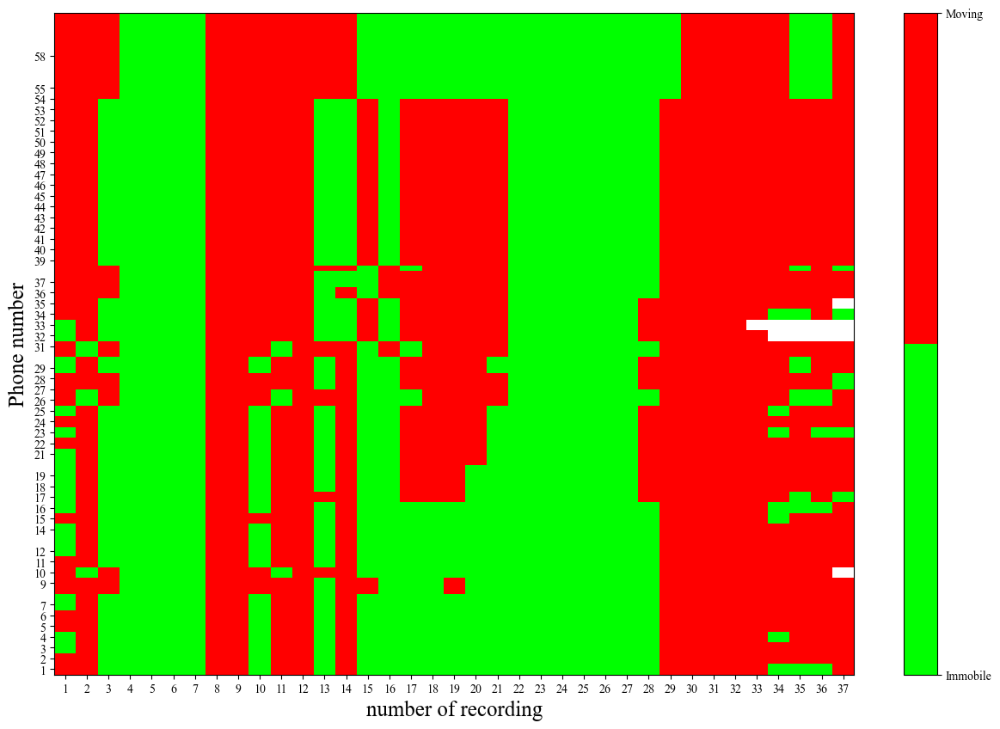

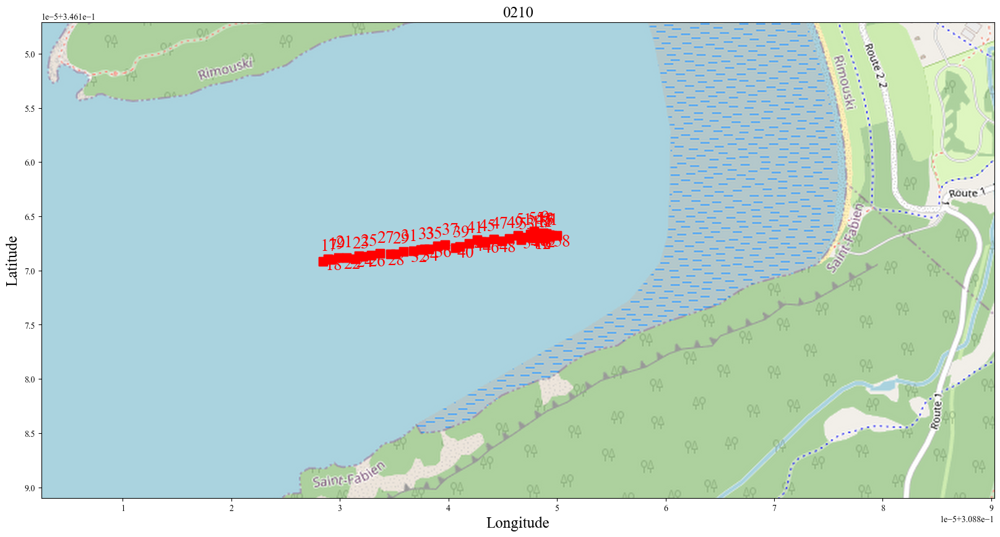

In [49]:
date = '0210'
pl.N0_to_N1(date,num=24,imax=32)

In [11]:
date = '0211'
synctime = pl.find_timetable(date)

please specify the folder path
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/
Found 30 phone folders : 
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 28, 17, 25, 26, 27, 31, 32, 35, 18, 19, 21, 22, 23, 24]
please specify the folder path
/media/turbots/BlueDisk/Shack25_local/Data/
/media/turbots/BlueDisk/Shack25_local/Data/
Phones not sync : []


In [12]:
print(files[1].keys())
print(files[1]['accelerometer'].keys())

dict_keys(['accelerometer', 'gyroscope', 'magnetic_field', 'gps'])
dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29])


In [82]:
files = pl.get_filelist(date)
for phone in phonelist:
    pl.display_times(files,synctime,phone)

please specify the folder path
Found 30 phone folders : 
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 28, 17, 25, 26, 27, 31, 32, 35, 18, 19, 21, 22, 23, 24]
please specify the folder path
1 ['17:20:06', '17:35:05']
2 ['17:35:07', '17:50:05']
3 ['17:50:07', '18:05:05']
4 ['18:05:07', '18:20:05']
5 ['18:20:07', '18:35:05']
6 ['18:35:07', '18:50:05']
7 ['18:50:07', '19:05:05']
8 ['19:05:07', '19:20:05']
9 ['19:20:07', '19:35:05']
10 ['19:35:07', '19:50:05']
11 ['19:50:07', '20:05:05']
12 ['20:05:07', '20:20:05']
13 ['20:20:07', '20:35:05']
14 ['20:35:07', '20:50:05']
15 ['20:50:07', '21:05:05']
16 ['21:05:07', '21:20:05']
17 ['21:20:07', '21:35:05']
18 ['21:35:07', '21:50:05']
19 ['21:50:07', '22:05:27']
20 ['22:05:29', '22:23:31']
21 ['22:23:33', '22:39:43']
22 ['22:39:45', '22:58:11']
1 ['17:20:47', '17:35:45']
2 ['17:35:47', '17:50:45']
3 ['17:50:47', '18:05:45']
4 ['18:05:47', '18:20:45']
5 ['18:20:47', '18:38:09']
6 ['18:38:11', '18:53:09']
7 ['18:53:11', '19:08:09']
8 ['

16 ['21:06:17', '21:21:15']
17 ['21:21:17', '21:36:15']
18 ['21:36:17', '21:51:15']
19 ['21:51:17', '22:06:20']
20 ['22:06:22', '22:21:20']
21 ['22:21:22', '22:36:20']
22 ['22:36:22', '22:51:20']
23 ['22:51:22', '23:08:16']
1 ['17:21:04', '17:36:02']
2 ['17:36:04', '17:51:02']
3 ['17:51:04', '18:06:02']
4 ['18:06:04', '18:21:02']
5 ['18:21:04', '18:36:02']
6 ['18:36:04', '18:51:02']
7 ['18:51:04', '19:06:02']
8 ['19:06:04', '19:21:02']
9 ['19:21:04', '19:36:02']
10 ['19:36:04', '19:51:02']
11 ['19:51:04', '20:06:02']
12 ['20:06:04', '20:21:02']
13 ['20:21:04', '20:36:02']
14 ['20:36:04', '20:51:02']
15 ['20:51:04', '21:06:02']
16 ['21:06:04', '21:21:02']
17 ['21:21:04', '21:36:02']
18 ['21:36:04', '21:51:02']
19 ['21:51:04', '22:06:12']
20 ['22:06:14', '22:21:12']
21 ['22:21:14', '22:36:12']
22 ['22:36:14', '22:51:12']
23 ['22:51:14', '23:06:19']
24 ['23:06:21', '23:23:32']
25 ['23:23:34', '23:44:21']
1 ['17:20:34', '17:35:32']
2 ['17:35:34', '17:50:32']
3 ['17:50:34', '18:05:32']
4 ['

38 ['02:34:40', '02:49:38']
39 ['02:49:40', '03:04:38']
40 ['03:04:40', '03:19:38']
41 ['03:19:40', '03:34:38']
42 ['03:34:40', '03:49:38']
43 ['03:49:40', '04:04:38']
44 ['04:04:40', '04:19:38']
45 ['04:19:40', '04:34:38']
46 ['04:34:40', '04:49:38']
47 ['04:49:40', '05:04:38']
48 ['05:04:40', '05:19:38']
49 ['05:19:40', '05:34:38']
50 ['05:34:40', '05:49:38']
51 ['05:49:40', '06:04:38']
52 ['06:04:40', '06:19:38']
53 ['06:19:40', '06:34:38']
54 ['06:34:40', '06:49:38']
55 ['06:49:40', '07:04:38']
56 ['07:04:40', '07:19:38']
57 ['07:19:40', '07:34:38']
1 ['17:19:19', '17:34:31']
2 ['17:34:33', '17:49:31']
3 ['17:49:33', '18:04:31']
4 ['18:04:33', '18:19:31']
5 ['18:19:33', '18:34:31']
6 ['18:34:33', '18:49:31']
7 ['18:49:33', '19:04:31']
8 ['19:04:33', '19:19:31']
9 ['19:19:33', '19:34:31']
10 ['19:34:33', '19:49:31']
11 ['19:49:33', '20:04:31']
12 ['20:04:33', '20:19:31']
13 ['20:19:33', '20:34:31']
14 ['20:34:33', '20:49:31']
15 ['20:49:33', '21:04:31']
16 ['21:04:33', '21:19:31']
1

5 ['18:19:10', '18:34:08']
6 ['18:34:10', '18:49:08']
7 ['18:49:10', '19:04:08']
8 ['19:04:10', '19:19:08']
9 ['19:19:10', '19:34:08']
10 ['19:34:10', '19:49:08']
11 ['19:49:10', '20:04:08']
12 ['20:04:10', '20:19:08']
13 ['20:19:10', '20:34:08']
14 ['20:34:10', '20:49:08']
15 ['20:49:10', '21:04:08']
16 ['21:04:10', '21:19:08']
17 ['21:19:10', '21:34:08']
18 ['21:34:10', '21:49:08']
19 ['21:49:10', '22:04:08']
20 ['22:04:10', '22:19:08']
21 ['22:19:10', '22:34:08']
22 ['22:34:10', '22:49:08']
23 ['22:49:10', '23:04:08']
24 ['23:04:10', '23:19:08']
25 ['23:19:10', '23:34:08']
26 ['23:34:10', '23:49:08']
27 ['23:49:10', '24:04:08']
28 ['00:04:10', '00:19:08']
29 ['00:19:10', '00:34:08']
30 ['00:34:10', '00:49:08']
31 ['00:49:10', '01:04:08']
32 ['01:04:10', '01:19:08']
33 ['01:19:10', '01:34:08']
34 ['01:34:10', '01:49:08']
35 ['01:49:10', '02:04:08']
36 ['02:04:10', '02:19:08']
37 ['02:19:10', '02:34:08']
38 ['02:34:10', '02:49:08']
39 ['02:49:10', '03:04:08']
40 ['03:04:10', '03:19:08

In [98]:
#pl.from_N0_to_N1(date)

r = pl.load_lvl_0(files,28,30)

In [105]:
pl.from_N0_to_N1(date)

please specify the folder path
Found 30 phone folders : 
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 28, 17, 25, 26, 27, 31, 32, 35, 18, 19, 21, 22, 23, 24]
please specify the folder path
please specify the folder path
Found 30 phone folders : 
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 28, 17, 25, 26, 27, 31, 32, 35, 18, 19, 21, 22, 23, 24]
please specify the folder path
Phones not sync : []
2025-02-11
/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/1/2025_02_11_L1_phone1_num1.h5


NameError: name 'toto' is not defined

In [110]:
files[phone]['gps'][10].split('.')[-2].split('-')

['/media/turbots/BlueDisk/Shack25_local/Data/0211/Phone/24/',
 '2025',
 '02',
 '11T11_32_17',
 'gps',
 '10',
 '185912285940',
 '186811284657']

In [13]:
phone = 1
num = 1
tmin = int(files[phone]['gps'][num].split('.')[-2].split('-')[-2])/10**6+synctime[phone]
tmax = int(files[phone]['gps'][num].split('.')[-2].split('-')[-1])/10**6+synctime[phone]
print(tmin,tmax)

print(timest.display_time(timest.today_time([tmin,tmax])))


1739294405.1063185 1739295305.1149004
['12:20:05', '12:35:05']


In [91]:
import h5py
hf = h5py.File('test.h5', 'w')

for key in r.keys():
    hf.create_dataset(key, data=r[key])
    
hf.close()

In [92]:
hf = h5py.File('test.h5','r')
print(hf.keys())



<KeysViewHDF5 ['ax', 'ay', 'az', 'coords', 'gpselev', 'gpslat', 'gpslon', 'gx', 'gy', 'gz', 'mx', 'my', 'mz', 'num', 'phone', 'ta', 'tg', 'tgps', 'tm']>


In [122]:
import icewave.field.gps as fieldgps

In [132]:
date = '0212'
records = fieldgps.get_records(date,year='2025',smb=True)

please specify the folder path
/home/turbots/Documents/Bic25/Data/
dict_keys([429, 430, 431, 432, 433, 434, 435, 436, 437, 438, 439, 440, 441, 442, 443, 444, 445, 446, 447, 448, 449, 450, 451, 452, 453, 454, 455, 456, 457, 458, 459, 461, 462, 463, 464, 465, 466, 467, 468, 469, 470, 471, 472, 473, 474, 475, 476, 477, 478, 479, 480, 481, 482, 483, 484, 485, 486, 487, 488, 489, 490, 491, 492])
429 492
429
430
431
432
433
434
435
436
437
438
439
440
441
442
443
444
445
446
447
448
449
450
451
452
453
454
455
456
457
458
459
461
462
463
464
465
466
467
468
469
470
471
472
473
474
475
476
477
478
479
480
481
482
483
484
485
486
487
488
489
490
491
492


In [137]:
print(records['gps']['garminSP']['depart'])
print(records['gps']['garminSP']['fin'])

{'longitude': [-68.798922], 'latitude': [48.348285], 'elevation': [13.164262], 'time': ['18:31:04'], 'name': ['depart']}
{'longitude': [-68.79896], 'latitude': [48.348305], 'elevation': [10.071106], 'time': ['22:38:48'], 'name': ['fin']}


In [71]:
files[1]['gps'][1]

'/media/turbots/BlueDisk/Shack25_local/Data/0210/Phone/1/-2025-02-10T09_03_56-gps-1-238983062338-239882095414.csv'

In [138]:
import icewave.field.multi_instruments as multi

date = '0210'
records = multi.get_records(date,year='2025')

/media/turbots/Hublot24/Share_hublot/Data/
[]
No data for mesange on 0210
[]
No data for Bernache on 0210
[]
No data for Fulmar on 0210
/media/turbots/Hublot24/Share_hublot/Data/
/media/turbots/Hublot24/Share_hublot/Data/
No jpg files for mesange on 0210
No jpg files for Bernache on 0210
No jpg files for Fulmar on 0210
{}
/media/turbots/Hublot24/Share_hublot/Data/
No GPS data for this day


/home/turbots/Documents/git/icewave/icewave/phone/pipeline.py:166: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  sc = ax.pcolormesh(Indices,Phones,moving,cmap=cmap)


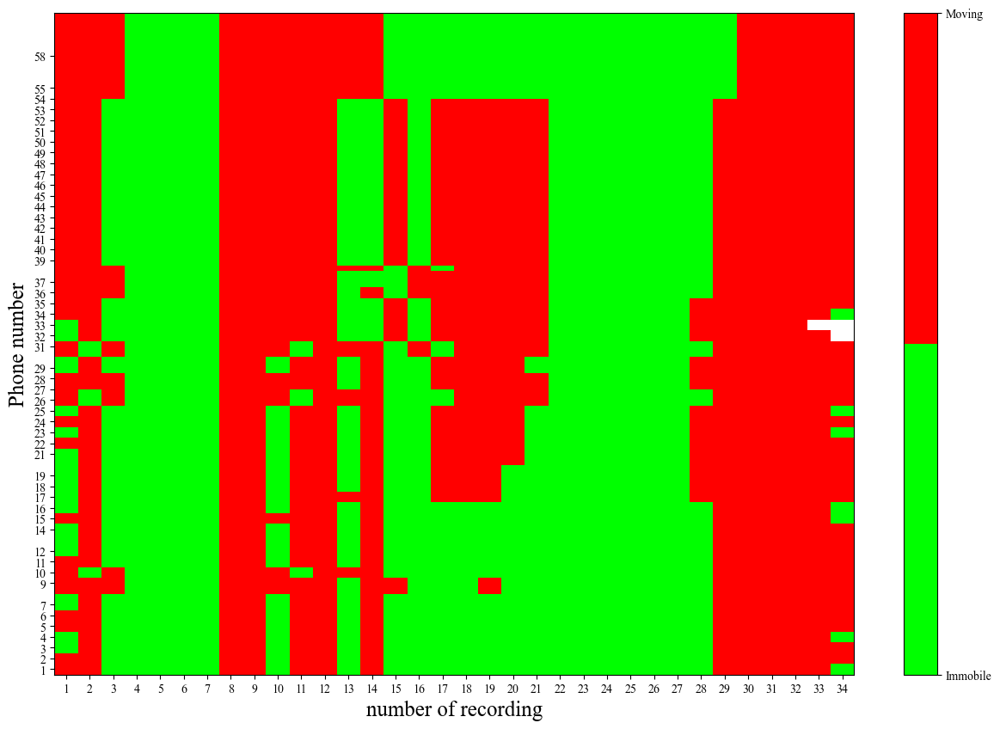

In [284]:
moving,indices = pl.moving_table(phonelist,files,imax=35)
fig,ax,figs = pl.moving_map(moving,indices,phonelist)
savefolder = pl.get_savefolder(date)
graphes.save_figs(figs,savedir=savefolder,prefix='Moving_map_')

In [261]:
savefolder

'/media/turbots/BlueDisk/Shack25_local/Data/0210/Phone/Results/'

Extent((0.3088025,0.34614708390131765)->(0.3088902777777778,0.3461909727902065) projected as normal)
No data for phone 42, num 24
No data for phone 50, num 24


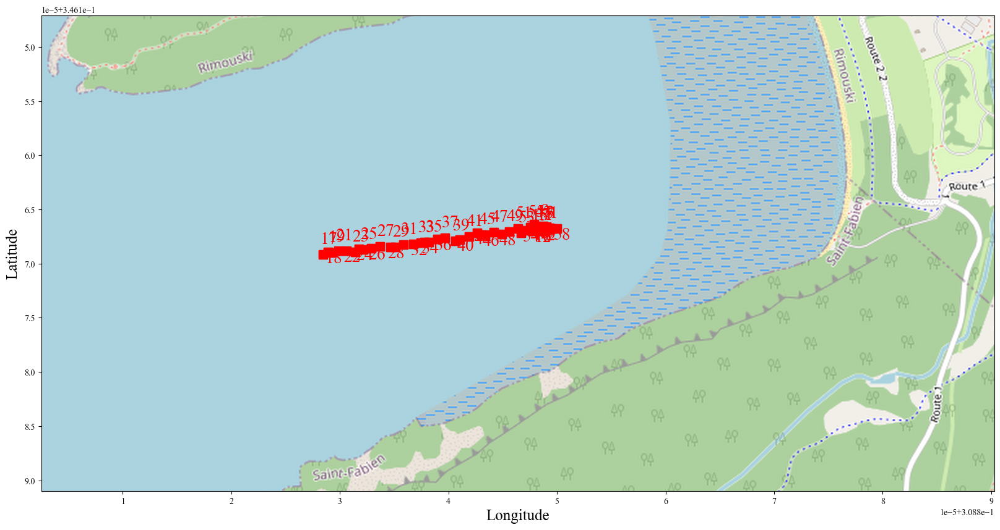

In [262]:
fig,ax,figs = pl.situation_map(files,phonelist,24)
savefolder = get_savefolder(date)
graphes.save_figs(figs,savedir=savefolder,prefix='Situation_map_')


In [257]:
nums = files[11]['gps'].keys()
print(nums)

dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38])


(51, 40)
(51, 40)


/tmp/ipykernel_25693/2636133108.py:7: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  ax.pcolormesh(Times,Phones,moving)


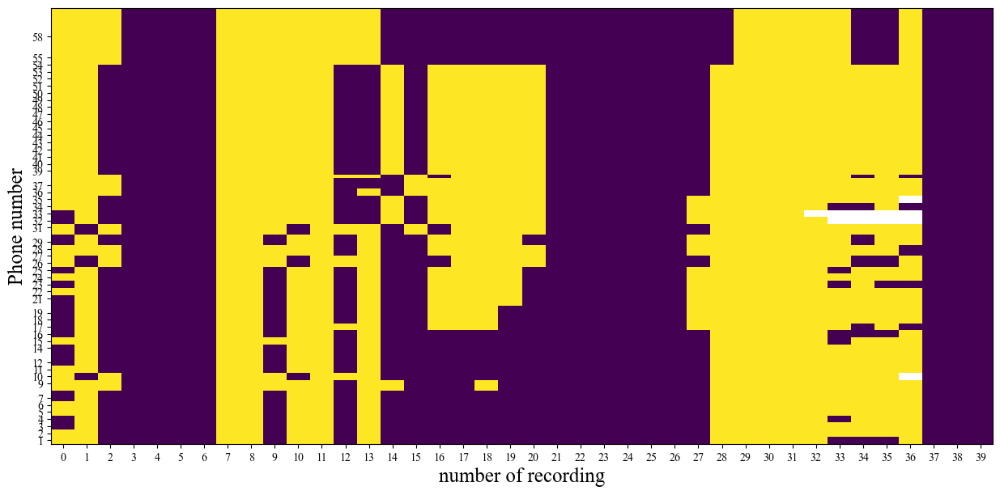

In [250]:
imin = 12
imax = 28

for phone in phonelist:
    

SyntaxError: incomplete input (3367967320.py, line 4)

In [192]:
print(files.keys())
print(files[58].keys())
print(files[58]['accelerometer'].keys())
print(files[58]['accelerometer'][25])


r = load_lvl0(files,58,10)

dict_keys([1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 26, 28, 29, 31, 32, 33, 34, 35, 36, 37, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 51, 52, 53, 54, 55, 27, 50, 58])
dict_keys(['magnetic_field', 'accelerometer', 'gyroscope', 'gps'])
dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39])
/media/turbots/BlueDisk/Shack25_local/Data/0210/Phone/58/-2025-02-10T09_03_28-android-sensor-accelerometer-25-416217719897-417146987841.csv


In [ ]:
#convert in local time using time table from the day


In [191]:
r.keys()

dict_keys(['num', 'phone', 'ta', 'coords', 'ax', 'ay', 'az', 'tg', 'gx', 'gy', 'gz', 'tm', 'mx', 'my', 'mz', 'tgps', 'gpslat', 'gpslon', 'gpselev'])

KeyboardInterrupt: 

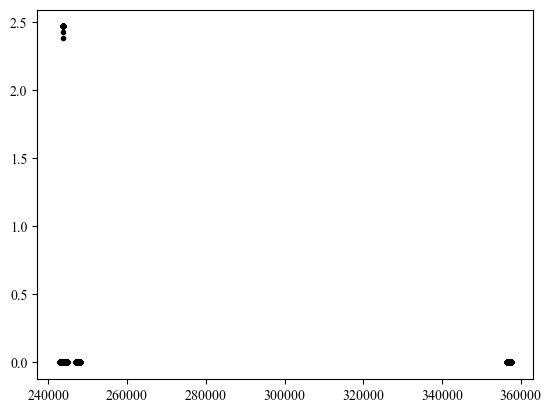

In [172]:
def diagnostic(r):
    t = r['tgps']
    X,Y = gps.project(r['gpslon'],r['gpslat'],meter=True)
    
    d = np.sqrt(X**2+Y**2)
    
    plt.plot(t,d,'k.')
    
    dmax = np.max(d)
    dmean = np.mean(d)

    return dmax,dmean

for phone in phonelist:
    print(phone)
    r = load_lvl0(files,phone,10)
    d = diagnostic(r)

dict_keys(['tm', 'coords', 'mx', 'my', 'mz', 'ta', 'ax', 'ay', 'az', 'tg', 'gx', 'gy', 'gz', 'tgps', 'gpslat', 'gpslon', 'gpselev'])


In [128]:
folder = '/media/turbots/BlueDisk/Shack25_local/Data/0210/Phone/58'

110.22222222222223

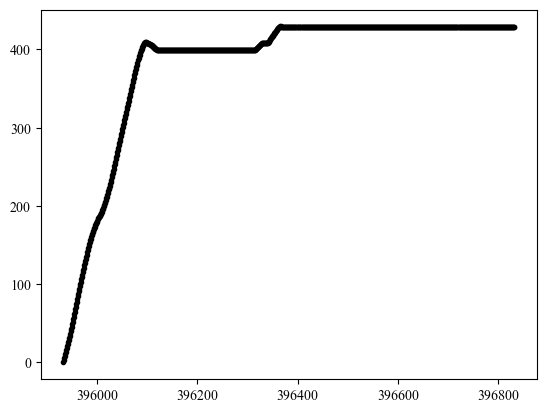

In [ ]:
r={}
phone = 1
gpsfiles = glob.glob(folder+'/*gps*')
r[phone]={}
r[phone]['GPS']=[]
for gpsfile in gpsfiles:
    dic = dataphone.load_data(gpsfile)
    r[phone]['GPS'].append(dic)
    #print(f"Number of files : {len(filelist)}")

In [ ]:
base = f'/media/turbots/BlueDisk/Shack25_local/'
savefolder = base + f'Data/{date}/Phone/Results/'

date = '0210'

folder = base +f'Data/{date}/Phone/'
folders = glob.glob(folder+'*')
#pprint(folders)
#filelist = glob.glob(folder+'*accelerometer-*')

r = {}
for folder in folders:
    try:
        phone = int(folder.split('/')[-1])
    except:
        print(f'{folder} is not a valid phone number')
        continue
    gpsfiles = glob.glob(folder+'/*gps*')
    print(phone)
    r[phone]={}
    r[phone]['GPS']=[]
    for gpsfile in gpsfiles:
        dic = dataphone.load_data(gpsfile)
        r[phone]['GPS'].append(dic)
        #print(f"Number of files : {len(filelist)}")

[-68.82426749999982, -68.81353416666687, 48.341832500000194, 48.352565833333145]
toto
Extent((0.30882147916666725,0.34615329002647444)->(0.3088512939814809,0.3461831048412881) projected as normal)


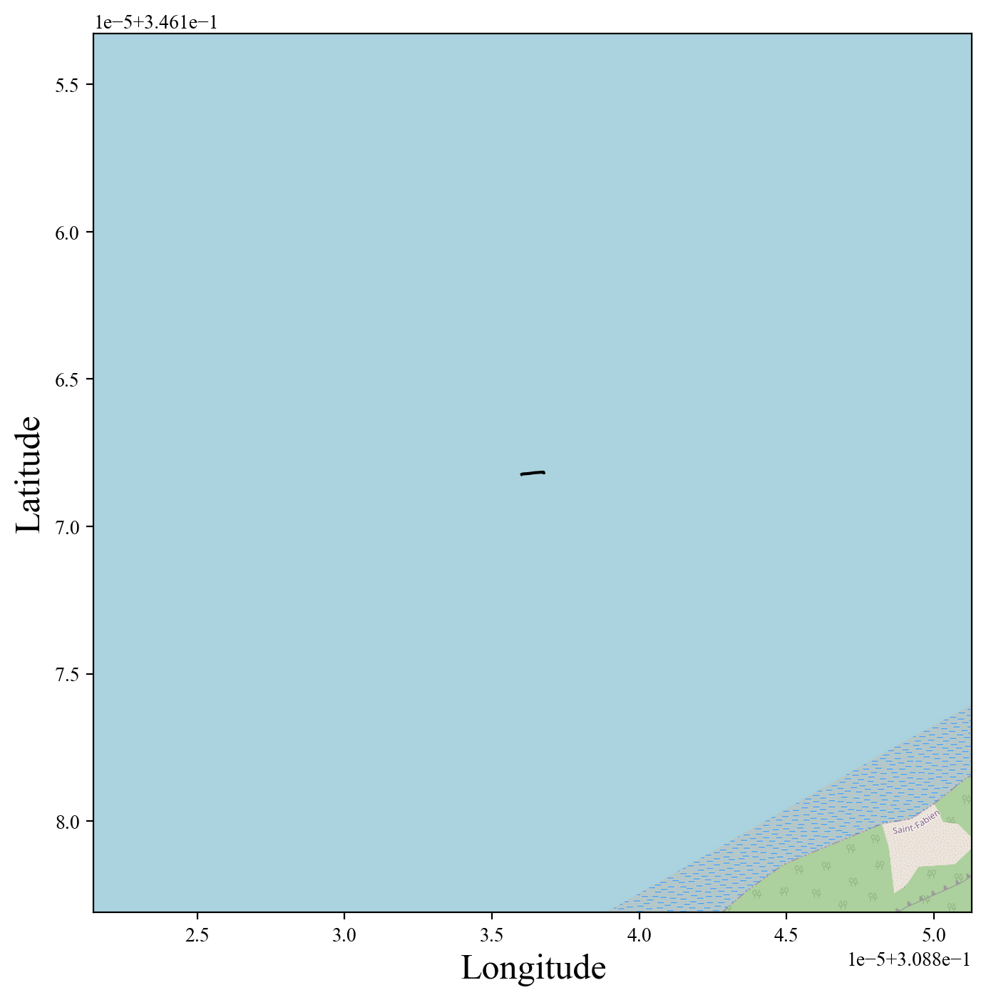

In [106]:
res = r[32]['GPS'][20]
ax,t,ext,figs = gps.map_traj(res['gpslon'],res['gpslat'],save=False,scale=20)


In [ ]:
#evaluate 

In [47]:
import icewave.gps.gps as gps



[-68.81512083333335, -68.81364416666666, 48.34680249999999, 48.34827916666668]
toto
Extent((0.308846886574074,0.3461647196561306)->(0.30885098842592595,0.34616882150798256) projected as normal)
-68.81417255222222 48.347525470246914


Text(0.3088495206882716, 0.34616683481529265, '1')

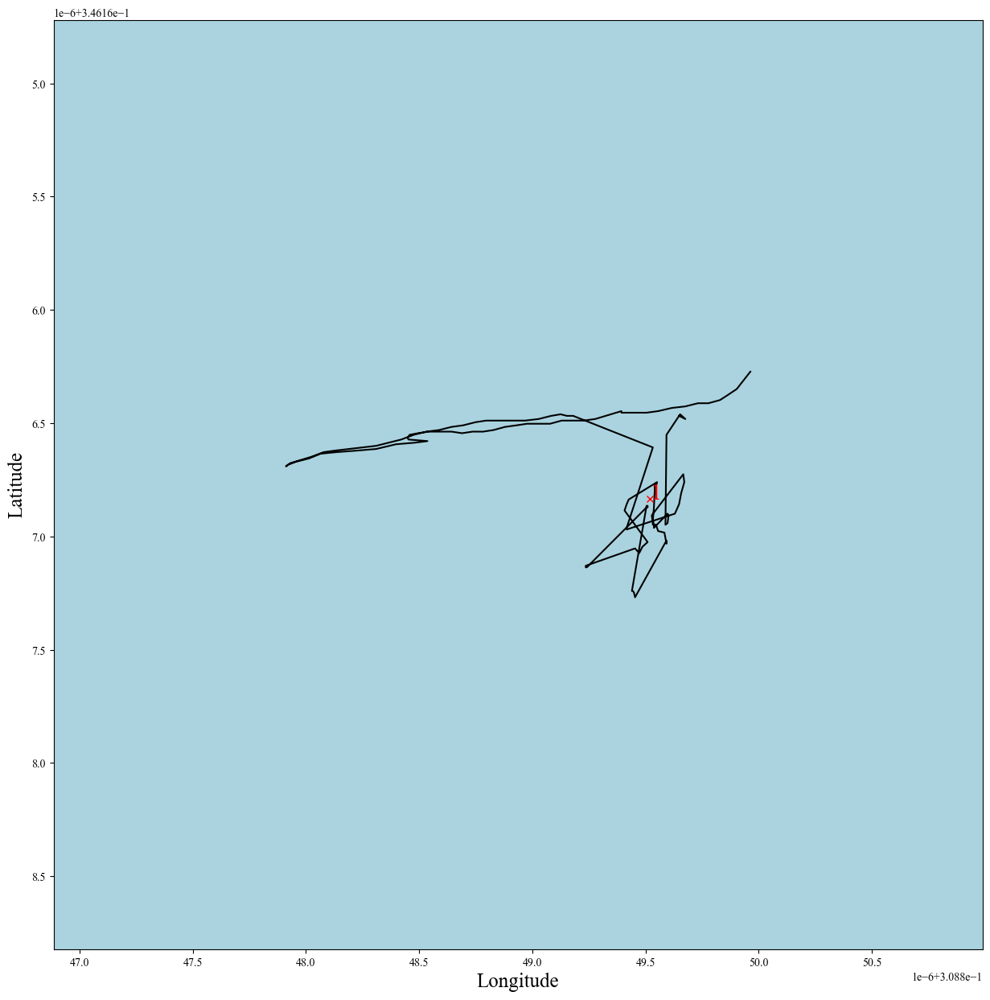

In [62]:
fig,ax = plt.subplots(figsize=(15,15))

cm = plt.colormaps['Oranges']

phone = 1
Long = []
Lat = []
for i,res in enumerate(r[phone]['GPS']):
    if i>=13 and i<28:
        color = phone
        n = len(res['gpslon'])
        dlon = res['gpslon'][-1]-res['gpslon'][0]
        dlat = res['gpslat'][-1]-res['gpslat'][0]
        dist = np.sqrt(dlon**2+dlat**2)
        #print(phone,i,dist*10**5)    
        Long=Long+list(res['gpslon'])
        Lat=Lat+list(res['gpslat'])        
#        ax.scatter(res['gpslon'],res['gpslat'],marker='.',c=color*np.ones(n),cmap='viridis',vmin=0,vmax=60)
#plt.colorbar()
        
Lonmean = np.mean(Long)
Latmean = np.mean(Lat)

ax,t,figs = gps.map_traj(Long,Lat,save=False,scale=1,title='',ax=ax)
X,Y = gps.project(Lonmean,Latmean)
plt.plot(X,Y,'rx')
print(Lonmean,Latmean)
ax.text(X,Y,str(phone),color='r',fontsize=20)

In [77]:
r.keys()
print(r[1]['GPS'][0].keys())

dict_keys(['tgps', 'gpslat', 'gpslon', 'gpselev'])


[-68.82426749999982, -68.81353416666687, 48.341832500000194, 48.352565833333145]
toto
Extent((0.30882147916666725,0.34615329002647444)->(0.3088512939814809,0.3461831048412881) projected as normal)


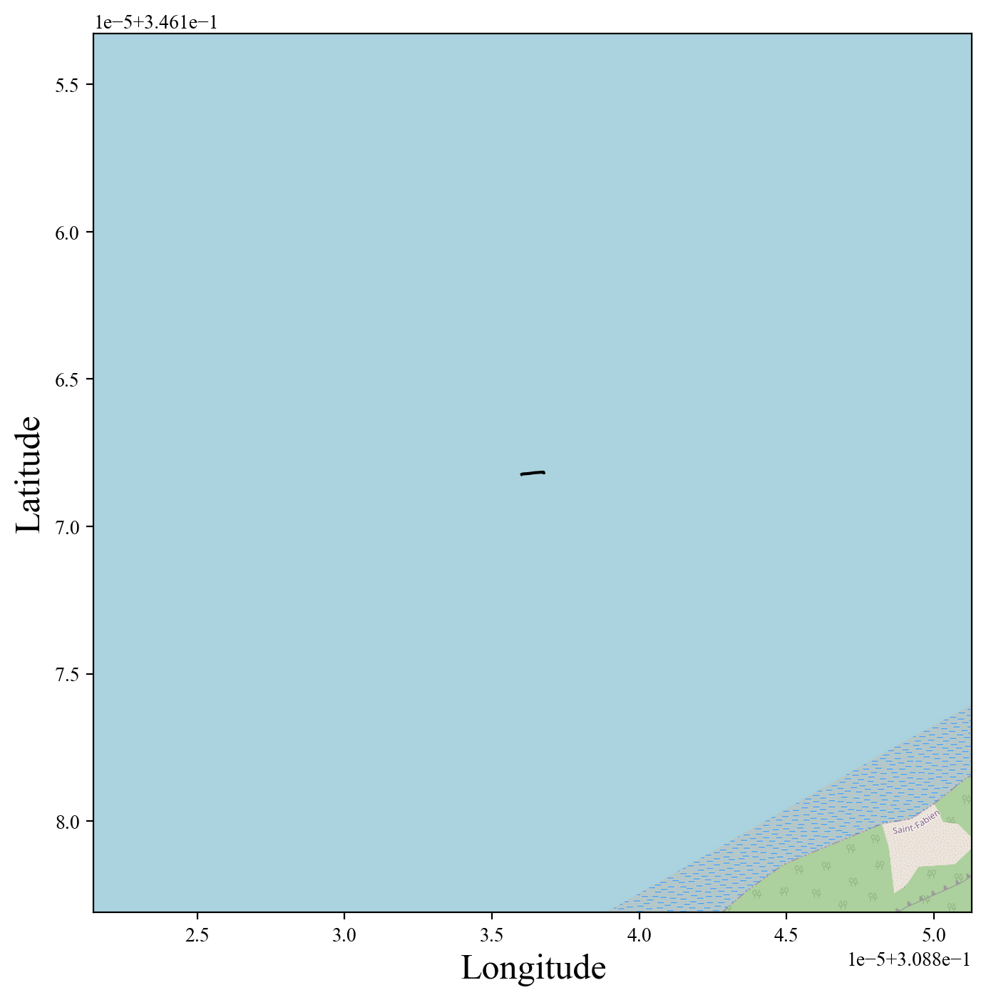

In [91]:
res = r[32]['GPS'][20]


In [94]:
0.3461680623776592-0.3461680114415486

5.093611060713599e-08

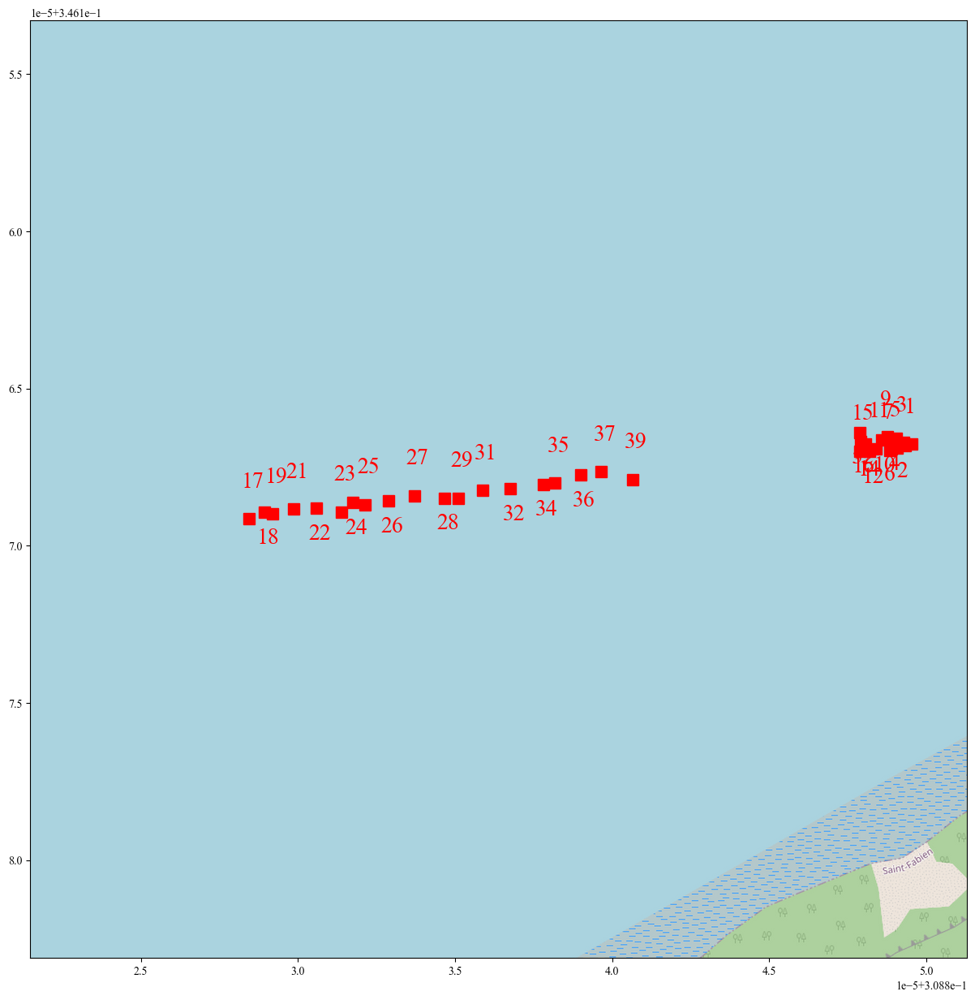

In [105]:

cm = plt.colormaps['Oranges']

phone = 1
Long = []
Lat = []

fig,ax = plt.subplots(figsize=(15,15))
import tilemapbase
plotter = tilemapbase.Plotter(ext, t, width=600)
plotter.plot(ax, t)

    
i = 23
for phone in r.keys():
    if len(r[phone]['GPS'])>phone:
        res = r[phone]['GPS'][i]
        color = phone
        n = len(res['gpslon'])
        dlon = res['gpslon'][-1]-res['gpslon'][0]
        dlat = res['gpslat'][-1]-res['gpslat'][0]
        dist = np.sqrt(dlon**2+dlat**2)
        #print(phone,i,dist*10**5)    

        Long=list(res['gpslon'])
        Lat=list(res['gpslat'])        
        Lonmean = np.mean(Long)
        Latmean = np.mean(Lat)
        X,Y = gps.project(Lonmean,Latmean)
        
        #print(X,Y)
        eps = 10**(-6)
        plt.plot(X,Y,'rs',markersize=10)
        sign = int((np.mod(phone,2)-0.5)*2)
        ax.text(X-eps/4,Y-eps*sign,str(phone),color='r',fontsize=20)

graphes.save_figs(figs,savedir=savefolder)

In [70]:

cm = plt.colormaps['Oranges']

phone = 1
Long = []
Lat = []


n = 15
fig,axs = plt.subplots(figsize=(18,5*n),nrows=15)

for phone in r.keys():
    for i,res in enumerate(r[phone]['GPS']):
        if i>=15 and i<30:
            ax = axs[i-15]
            color = phone
            n = len(res['gpslon'])
            dlon = res['gpslon'][-1]-res['gpslon'][0]
            dlat = res['gpslat'][-1]-res['gpslat'][0]
            dist = np.sqrt(dlon**2+dlat**2)
            print(phone,i,dist*10**5)    
            Long=list(res['gpslon'])
            Lat=list(res['gpslat'])        
    #        ax.scatter(res['gpslon'],res['gpslat'],marker='.',c=color*np.ones(n),cmap='viridis',vmin=0,vmax=60)
    #plt.colorbar()
            Lonmean = np.mean(Long)
            Latmean = np.mean(Lat)
            try:
                ax,t,figs = gps.map_traj(Long,Lat,save=False,scale=1,title='',ax=ax)
                X,Y = gps.project(Lonmean,Latmean)
                plt.plot(X,Y,'rx')
                print(Lonmean,Latmean)
                ax.text(X,Y,str(phone),color='r',fontsize=20)
            except:
                print(f'cannot find phone {phone}')

1 15 2.0275875105872405
[-68.81414083333334, -68.81410083333333, 48.34752166666666, 48.34756166666667]
toto
Extent((0.3088496087962963,0.3461667115658742)->(0.3088497199074075,0.3461668226769854) projected as normal)
-68.81412000185186 48.34755163518518
1 16 7.490735017792559
[-68.81421833333334, -68.81407166666665, 48.34744166666666, 48.34758833333334]
toto
Extent((0.3088493935185185,0.3461666748723424)->(0.30884980092592595,0.34616708227974985) projected as normal)
-68.81413951111108 48.347502116666675
1 17 0.0
[-68.81414666666666, -68.81414666666666, 48.34748166666667, 48.34748166666667]
toto
cannot find phone 1
1 18 7.661229956631554
[-68.81423416666667, -68.81411416666666, 48.347391666666674, 48.34751166666667]
toto
Extent((0.308849349537037,0.3461669766144172)->(0.3088496828703704,0.3461673099477506) projected as normal)
-68.81415050555553 48.34747792407408
1 19 0.0
[-68.81420166666666, -68.81420166666666, 48.34742833333333, 48.34742833333333]
toto
cannot find phone 1
1 20 5.7397

2025-02-12 11:04:31,608 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40481/45370.png
2025-02-12 11:04:31,608 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40481/45370.png
2025-02-12 11:04:31,608 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40481/45370.png
2025-02-12 11:04:31,608 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40481/45370.png
2025-02-12 11:04:31,608 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40481/45370.png
2025-02-12 11:04:31,608 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40481/45370.png
2025-02-12 11:04:31,608 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40481/45370.png
2025-02-12 11:04:31,608 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40481/45370.png
2025-02-12 11:04:31,608 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40481/45370.png
2

2025-02-12 11:04:31,857 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45370.png
2025-02-12 11:04:31,857 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45370.png
2025-02-12 11:04:31,857 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45370.png
2025-02-12 11:04:31,857 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45370.png
2025-02-12 11:04:31,857 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45370.png
2025-02-12 11:04:31,857 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45370.png
2025-02-12 11:04:31,857 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45370.png
2025-02-12 11:04:31,857 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45370.png
2025-02-12 11:04:31,857 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45370.png
2

2025-02-12 11:04:32,207 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45373.png
2025-02-12 11:04:32,207 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45373.png
2025-02-12 11:04:32,207 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45373.png
2025-02-12 11:04:32,207 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45373.png
2025-02-12 11:04:32,207 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45373.png
2025-02-12 11:04:32,207 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45373.png
2025-02-12 11:04:32,207 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45373.png
2025-02-12 11:04:32,207 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45373.png
2025-02-12 11:04:32,207 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45373.png
2

2025-02-12 11:04:32,411 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45374.png
2025-02-12 11:04:32,411 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45374.png
2025-02-12 11:04:32,411 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45374.png
2025-02-12 11:04:32,411 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45374.png
2025-02-12 11:04:32,411 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45374.png
2025-02-12 11:04:32,411 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45374.png
2025-02-12 11:04:32,411 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45374.png
2025-02-12 11:04:32,411 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45374.png
2025-02-12 11:04:32,411 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40484/45374.png
2

2025-02-12 11:04:32,822 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20244/22685.png
2025-02-12 11:04:32,822 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20244/22685.png
2025-02-12 11:04:32,822 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20244/22685.png
2025-02-12 11:04:32,822 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20244/22685.png
2025-02-12 11:04:32,822 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20244/22685.png
2025-02-12 11:04:32,822 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20244/22685.png
2025-02-12 11:04:32,822 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20244/22685.png
2025-02-12 11:04:32,822 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20244/22685.png
2025-02-12 11:04:32,822 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20244/22685.png
2

-68.80499236851851 48.34752199629631
9 15 0.0
[-68.81438833333333, -68.81438833333333, 48.34730666666666, 48.34730666666666]
toto
cannot find phone 9
9 16 0.0
[-68.81438833333333, -68.81438833333333, 48.34730666666666, 48.34730666666666]
toto
cannot find phone 9
9 17 12.438738770929122
[-68.81452083333332, -68.81431749999999, 48.34715416666668, 48.347357499999994]
toto
Extent((0.3088485532407408,0.3461676793669343)->(0.3088491180555556,0.34616824418174913) projected as normal)
-68.81438950185185 48.34728642407407
9 18 30.905321368534274
[-68.8148175, -68.81420416666666, 48.347051666666665, 48.347665]
toto
Extent((0.30884772916666664,0.34616668151645097)->(0.3088494328703704,0.34616838522015475) projected as normal)
-68.81450228148147 48.347395429629636
9 19 10.034662149267689
[-68.81455666666666, -68.81438666666666, 48.34746916666667, 48.34763916666667]
toto
Extent((0.30884845370370373,0.3461664787655716)->(0.30884892592592594,0.3461669509877938) projected as normal)
-68.81445934814813

2025-02-12 11:04:34,871 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80961/90745.png
2025-02-12 11:04:34,871 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80961/90745.png
2025-02-12 11:04:34,871 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80961/90745.png
2025-02-12 11:04:34,871 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80961/90745.png
2025-02-12 11:04:34,871 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80961/90745.png
2025-02-12 11:04:34,871 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80961/90745.png
2025-02-12 11:04:34,871 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80961/90745.png
2025-02-12 11:04:34,871 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80961/90745.png
2025-02-12 11:04:34,871 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80961/90745.png
2

2025-02-12 11:04:35,113 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90743.png
2025-02-12 11:04:35,113 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90743.png
2025-02-12 11:04:35,113 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90743.png
2025-02-12 11:04:35,113 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90743.png
2025-02-12 11:04:35,113 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90743.png
2025-02-12 11:04:35,113 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90743.png
2025-02-12 11:04:35,113 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90743.png
2025-02-12 11:04:35,113 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90743.png
2025-02-12 11:04:35,113 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90743.png
2

2025-02-12 11:04:35,362 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90746.png
2025-02-12 11:04:35,362 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90746.png
2025-02-12 11:04:35,362 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90746.png
2025-02-12 11:04:35,362 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90746.png
2025-02-12 11:04:35,362 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90746.png
2025-02-12 11:04:35,362 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90746.png
2025-02-12 11:04:35,362 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90746.png
2025-02-12 11:04:35,362 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90746.png
2025-02-12 11:04:35,362 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80962/90746.png
2

2025-02-12 11:04:35,597 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90744.png
2025-02-12 11:04:35,597 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90744.png
2025-02-12 11:04:35,597 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90744.png
2025-02-12 11:04:35,597 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90744.png
2025-02-12 11:04:35,597 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90744.png
2025-02-12 11:04:35,597 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90744.png
2025-02-12 11:04:35,597 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90744.png
2025-02-12 11:04:35,597 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90744.png
2025-02-12 11:04:35,597 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90744.png
2

2025-02-12 11:04:35,833 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90747.png
2025-02-12 11:04:35,833 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90747.png
2025-02-12 11:04:35,833 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90747.png
2025-02-12 11:04:35,833 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90747.png
2025-02-12 11:04:35,833 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90747.png
2025-02-12 11:04:35,833 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90747.png
2025-02-12 11:04:35,833 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90747.png
2025-02-12 11:04:35,833 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90747.png
2025-02-12 11:04:35,833 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80963/90747.png
2

2025-02-12 11:04:36,199 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80964/90745.png
2025-02-12 11:04:36,199 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80964/90745.png
2025-02-12 11:04:36,199 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80964/90745.png
2025-02-12 11:04:36,199 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80964/90745.png
2025-02-12 11:04:36,199 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80964/90745.png
2025-02-12 11:04:36,199 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80964/90745.png
2025-02-12 11:04:36,199 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80964/90745.png
2025-02-12 11:04:36,199 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80964/90745.png
2025-02-12 11:04:36,199 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80964/90745.png
2

2025-02-12 11:04:36,450 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90743.png
2025-02-12 11:04:36,450 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90743.png
2025-02-12 11:04:36,450 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90743.png
2025-02-12 11:04:36,450 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90743.png
2025-02-12 11:04:36,450 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90743.png
2025-02-12 11:04:36,450 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90743.png
2025-02-12 11:04:36,450 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90743.png
2025-02-12 11:04:36,450 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90743.png
2025-02-12 11:04:36,450 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90743.png
2

2025-02-12 11:04:36,685 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90746.png
2025-02-12 11:04:36,685 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90746.png
2025-02-12 11:04:36,685 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90746.png
2025-02-12 11:04:36,685 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90746.png
2025-02-12 11:04:36,685 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90746.png
2025-02-12 11:04:36,685 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90746.png
2025-02-12 11:04:36,685 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90746.png
2025-02-12 11:04:36,685 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90746.png
2025-02-12 11:04:36,685 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80965/90746.png
2

-68.81071738888889 48.34764765740741
11 15 9.285592183791705
[-68.81464333333334, -68.81447000000001, 48.34746333333334, 48.34763666666666]
toto
Extent((0.30884821296296294,0.3461664915507541)->(0.3088486944444444,0.34616697303223554) projected as normal)
-68.81455055555556 48.34756588888888
11 16 0.0
[-68.81457333333333, -68.81457333333333, 48.34750666666667, 48.34750666666667]
toto
cannot find phone 11
11 17 0.0
[-68.81457333333333, -68.81457333333333, 48.34750666666667, 48.34750666666667]
toto
cannot find phone 11
11 18 0.0
[-68.81457333333333, -68.81457333333333, 48.34750666666667, 48.34750666666667]
toto
cannot find phone 11
11 19 0.0
[-68.81457333333333, -68.81457333333333, 48.34750666666667, 48.34750666666667]
toto
cannot find phone 11
11 20 0.0
[-68.81457333333333, -68.81457333333333, 48.34750666666667, 48.34750666666667]
toto
cannot find phone 11
11 21 0.0
[-68.81457333333333, -68.81457333333333, 48.34750666666667, 48.34750666666667]
toto
cannot find phone 11
11 22 0.0
[-68.81

2025-02-12 11:04:37,092 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90744.png
2025-02-12 11:04:37,092 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90744.png
2025-02-12 11:04:37,092 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90744.png
2025-02-12 11:04:37,092 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90744.png
2025-02-12 11:04:37,092 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90744.png
2025-02-12 11:04:37,092 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90744.png
2025-02-12 11:04:37,092 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90744.png
2025-02-12 11:04:37,092 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90744.png
2025-02-12 11:04:37,092 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90744.png
2

2025-02-12 11:04:37,330 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90747.png
2025-02-12 11:04:37,330 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90747.png
2025-02-12 11:04:37,330 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90747.png
2025-02-12 11:04:37,330 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90747.png
2025-02-12 11:04:37,330 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90747.png
2025-02-12 11:04:37,330 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90747.png
2025-02-12 11:04:37,330 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90747.png
2025-02-12 11:04:37,330 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90747.png
2025-02-12 11:04:37,330 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90747.png
2

2025-02-12 11:04:37,585 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161919/181491.png
2025-02-12 11:04:37,585 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161919/181491.png
2025-02-12 11:04:37,585 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161919/181491.png
2025-02-12 11:04:37,585 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161919/181491.png
2025-02-12 11:04:37,585 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161919/181491.png
2025-02-12 11:04:37,585 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161919/181491.png
2025-02-12 11:04:37,585 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161919/181491.png
2025-02-12 11:04:37,585 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161919/181491.png
2025-02-12 11:04:37,585 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:37,830 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181489.png
2025-02-12 11:04:37,830 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181489.png
2025-02-12 11:04:37,830 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181489.png
2025-02-12 11:04:37,830 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181489.png
2025-02-12 11:04:37,830 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181489.png
2025-02-12 11:04:37,830 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181489.png
2025-02-12 11:04:37,830 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181489.png
2025-02-12 11:04:37,830 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181489.png
2025-02-12 11:04:37,830 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:38,106 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181492.png
2025-02-12 11:04:38,106 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181492.png
2025-02-12 11:04:38,106 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181492.png
2025-02-12 11:04:38,106 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181492.png
2025-02-12 11:04:38,106 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181492.png
2025-02-12 11:04:38,106 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181492.png
2025-02-12 11:04:38,106 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181492.png
2025-02-12 11:04:38,106 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181492.png
2025-02-12 11:04:38,106 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:38,339 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181490.png
2025-02-12 11:04:38,339 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181490.png
2025-02-12 11:04:38,339 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181490.png
2025-02-12 11:04:38,339 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181490.png
2025-02-12 11:04:38,339 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181490.png
2025-02-12 11:04:38,339 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181490.png
2025-02-12 11:04:38,339 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181490.png
2025-02-12 11:04:38,339 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181490.png
2025-02-12 11:04:38,339 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:38,545 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181492.png
2025-02-12 11:04:38,545 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181492.png
2025-02-12 11:04:38,545 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181492.png
2025-02-12 11:04:38,545 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181492.png
2025-02-12 11:04:38,545 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181492.png
2025-02-12 11:04:38,545 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181492.png
2025-02-12 11:04:38,545 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181492.png
2025-02-12 11:04:38,545 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181492.png
2025-02-12 11:04:38,545 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:38,761 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181493.png
2025-02-12 11:04:38,761 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181493.png
2025-02-12 11:04:38,761 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181493.png
2025-02-12 11:04:38,761 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181493.png
2025-02-12 11:04:38,761 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181493.png
2025-02-12 11:04:38,761 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181493.png
2025-02-12 11:04:38,761 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181493.png
2025-02-12 11:04:38,761 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181493.png
2025-02-12 11:04:38,761 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:38,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181490.png
2025-02-12 11:04:38,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181490.png
2025-02-12 11:04:38,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181490.png
2025-02-12 11:04:38,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181490.png
2025-02-12 11:04:38,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181490.png
2025-02-12 11:04:38,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181490.png
2025-02-12 11:04:38,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181490.png
2025-02-12 11:04:38,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181490.png
2025-02-12 11:04:38,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:39,271 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181492.png
2025-02-12 11:04:39,271 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181492.png
2025-02-12 11:04:39,271 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181492.png
2025-02-12 11:04:39,271 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181492.png
2025-02-12 11:04:39,271 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181492.png
2025-02-12 11:04:39,271 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181492.png
2025-02-12 11:04:39,271 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181492.png
2025-02-12 11:04:39,271 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161922/181492.png
2025-02-12 11:04:39,271 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:39,681 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181490.png
2025-02-12 11:04:39,681 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181490.png
2025-02-12 11:04:39,681 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181490.png
2025-02-12 11:04:39,681 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181490.png
2025-02-12 11:04:39,681 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181490.png
2025-02-12 11:04:39,681 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181490.png
2025-02-12 11:04:39,681 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181490.png
2025-02-12 11:04:39,681 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181490.png
2025-02-12 11:04:39,681 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:39,911 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181493.png
2025-02-12 11:04:39,911 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181493.png
2025-02-12 11:04:39,911 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181493.png
2025-02-12 11:04:39,911 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181493.png
2025-02-12 11:04:39,911 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181493.png
2025-02-12 11:04:39,911 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181493.png
2025-02-12 11:04:39,911 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181493.png
2025-02-12 11:04:39,911 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161923/181493.png
2025-02-12 11:04:39,911 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:40,110 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45372.png
2025-02-12 11:04:40,110 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45372.png
2025-02-12 11:04:40,110 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45372.png
2025-02-12 11:04:40,110 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45372.png
2025-02-12 11:04:40,110 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45372.png
2025-02-12 11:04:40,110 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45372.png
2025-02-12 11:04:40,110 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45372.png
2025-02-12 11:04:40,110 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45372.png
2025-02-12 11:04:40,110 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45372.png
2

2025-02-12 11:04:40,352 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45371.png
2025-02-12 11:04:40,352 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45371.png
2025-02-12 11:04:40,352 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45371.png
2025-02-12 11:04:40,352 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45371.png
2025-02-12 11:04:40,352 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45371.png
2025-02-12 11:04:40,352 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45371.png
2025-02-12 11:04:40,352 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45371.png
2025-02-12 11:04:40,352 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45371.png
2025-02-12 11:04:40,352 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45371.png
2

2025-02-12 11:04:40,594 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45374.png
2025-02-12 11:04:40,594 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45374.png
2025-02-12 11:04:40,594 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45374.png
2025-02-12 11:04:40,594 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45374.png
2025-02-12 11:04:40,594 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45374.png
2025-02-12 11:04:40,594 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45374.png
2025-02-12 11:04:40,594 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45374.png
2025-02-12 11:04:40,594 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45374.png
2025-02-12 11:04:40,594 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40479/45374.png
2

2025-02-12 11:04:40,844 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90745.png
2025-02-12 11:04:40,844 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90745.png
2025-02-12 11:04:40,844 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90745.png
2025-02-12 11:04:40,844 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90745.png
2025-02-12 11:04:40,844 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90745.png
2025-02-12 11:04:40,844 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90745.png
2025-02-12 11:04:40,844 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90745.png
2025-02-12 11:04:40,844 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90745.png
2025-02-12 11:04:40,844 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90745.png
2

-68.81308665925927 48.347632281481474
18 29 867.8383265970693
[-68.81387083333333, -68.79660083333333, 48.3392, 48.356469999999995]
toto
Extent((0.3088503587962963,0.34614155194591456)->(0.3088983310185185,0.34618952416813686) projected as normal)
-68.80525070370369 48.34751776666667
19 15 10.725100362171023
[-68.81462833333333, -68.81447499999999, 48.34749166666666, 48.34764500000001]
toto
Extent((0.3088482546296296,0.34616644270336333)->(0.3088486805555556,0.3461668686292893) projected as normal)
-68.81451450185186 48.34760547962963
19 16 199.42368353689224
[-68.81757083333333, -68.81359416666668, 48.345491666666675, 48.349468333333334]
toto
Extent((0.30884008101851845,0.3461615015503686)->(0.3088511273148148,0.34617254784666496) projected as normal)
-68.81538796296296 48.34747861666667
19 17 159.97612669060058
[-68.8189925, -68.8158025, 48.34572833333334, 48.34891833333333]
toto
Extent((0.3088361319444445,0.3461632489961997)->(0.3088449930555556,0.3461721101073108) projected as norm

2025-02-12 11:04:41,280 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181492.png
2025-02-12 11:04:41,280 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181492.png
2025-02-12 11:04:41,280 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181492.png
2025-02-12 11:04:41,280 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181492.png
2025-02-12 11:04:41,280 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181492.png
2025-02-12 11:04:41,280 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181492.png
2025-02-12 11:04:41,280 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181492.png
2025-02-12 11:04:41,280 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181492.png
2025-02-12 11:04:41,280 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:41,629 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45371.png
2025-02-12 11:04:41,629 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45371.png
2025-02-12 11:04:41,629 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45371.png
2025-02-12 11:04:41,629 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45371.png
2025-02-12 11:04:41,629 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45371.png
2025-02-12 11:04:41,629 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45371.png
2025-02-12 11:04:41,629 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45371.png
2025-02-12 11:04:41,629 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45371.png
2025-02-12 11:04:41,629 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45371.png
2

2025-02-12 11:04:41,869 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45374.png
2025-02-12 11:04:41,869 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45374.png
2025-02-12 11:04:41,869 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45374.png
2025-02-12 11:04:41,869 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45374.png
2025-02-12 11:04:41,869 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45374.png
2025-02-12 11:04:41,869 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45374.png
2025-02-12 11:04:41,869 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45374.png
2025-02-12 11:04:41,869 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45374.png
2025-02-12 11:04:41,869 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40477/45374.png
2

2025-02-12 11:04:42,109 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45375.png
2025-02-12 11:04:42,109 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45375.png
2025-02-12 11:04:42,109 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45375.png
2025-02-12 11:04:42,109 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45375.png
2025-02-12 11:04:42,109 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45375.png
2025-02-12 11:04:42,109 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45375.png
2025-02-12 11:04:42,109 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45375.png
2025-02-12 11:04:42,109 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45375.png
2025-02-12 11:04:42,109 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40478/45375.png
2

2025-02-12 11:04:42,363 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40480/45375.png
2025-02-12 11:04:42,363 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40480/45375.png
2025-02-12 11:04:42,363 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40480/45375.png
2025-02-12 11:04:42,363 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40480/45375.png
2025-02-12 11:04:42,363 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40480/45375.png
2025-02-12 11:04:42,363 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40480/45375.png
2025-02-12 11:04:42,363 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40480/45375.png
2025-02-12 11:04:42,363 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40480/45375.png
2025-02-12 11:04:42,363 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40480/45375.png
2

-68.81911821666667 48.34719789259259
21 28 471.2624298402976
[-68.81729416666668, -68.80787083333333, 48.34289416666665, 48.35231750000001]
toto
Extent((0.30884084953703705,0.34615341005976674)->(0.30886702546296296,0.34617958598569276) projected as normal)
-68.81319553333333 48.34763469074073
21 29 905.9559867896021
[-68.81471833333333, -68.79663833333333, 48.338669166666676, 48.356749166666674]
toto
Extent((0.3088480046296296,0.3461409525823502)->(0.30889822685185186,0.3461911748045725) projected as normal)
-68.80547214814816 48.347496964814816
22 15 0.0
[-68.81453166666667, -68.81453166666667, 48.34755499999999, 48.34755499999999]
toto
cannot find phone 22
22 16 205.62269924425883
[-68.81760416666667, -68.8135075, 48.34542083333333, 48.3495175]
toto
Extent((0.30883998842592586,0.3461613801522436)->(0.3088513680555556,0.34617275978187334) projected as normal)
-68.81536747962963 48.34748424814815
22 17 157.8694960323325
[-68.81895999999999, -68.81581333333334, 48.34573750000001, 48.34

-68.82103133518517 48.347051903703694
22 20 0.0
[-68.82098333333333, -68.82098333333333, 48.34705666666667, 48.34705666666667]
toto
cannot find phone 22
22 21 0.0
[-68.82098333333333, -68.82098333333333, 48.34705666666667, 48.34705666666667]
toto
cannot find phone 22
22 22 0.0
[-68.82098333333333, -68.82098333333333, 48.34705666666667, 48.34705666666667]
toto
cannot find phone 22
22 23 4.447221353812565
[-68.82106333333333, -68.82092666666667, 48.34695416666667, 48.34709083333333]
toto
Extent((0.30883037962962967,0.3461687471819915)->(0.3088307592592593,0.3461691268116211) projected as normal)
-68.82098467037035 48.3470519074074
22 24 0.0
[-68.82099333333333, -68.82099333333333, 48.347013333333344, 48.347013333333344]
toto
cannot find phone 22
22 25 0.0
[-68.82099333333333, -68.82099333333333, 48.347013333333344, 48.347013333333344]
toto
cannot find phone 22
22 26 0.0
[-68.82099333333333, -68.82099333333333, 48.347013333333344, 48.347013333333344]
toto
cannot find phone 22
22 27 603.97

2025-02-12 11:04:43,139 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181491.png
2025-02-12 11:04:43,139 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181491.png
2025-02-12 11:04:43,139 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181491.png
2025-02-12 11:04:43,139 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181491.png
2025-02-12 11:04:43,139 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181491.png
2025-02-12 11:04:43,139 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181491.png
2025-02-12 11:04:43,139 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181491.png
2025-02-12 11:04:43,139 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181491.png
2025-02-12 11:04:43,139 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

-68.82074692407406 48.34708447037036
23 20 10.609220308407352
[-68.82074, -68.82058666666666, 48.34698666666667, 48.34714]
toto
Extent((0.30883127777777786,0.34616855337022545)->(0.3088317037037037,0.3461689792961513) projected as normal)
-68.82069103703704 48.34703437037038
23 21 0.0
[-68.8207, -68.8207, 48.347025, 48.347025]
toto
cannot find phone 23
23 22 0.0
[-68.8207, -68.8207, 48.347025, 48.347025]
toto
cannot find phone 23
23 23 0.0
[-68.8207, -68.8207, 48.347025, 48.347025]
toto
cannot find phone 23
23 24 0.0
[-68.8207, -68.8207, 48.347025, 48.347025]
toto
cannot find phone 23
23 25 0.0
[-68.8207, -68.8207, 48.347025, 48.347025]
toto
cannot find phone 23
23 26 0.0
[-68.8207, -68.8207, 48.347025, 48.347025]
toto
cannot find phone 23
23 27 580.9834813102752
[-68.82359333333333, -68.81202, 48.3414975, 48.353070833333334]
toto
Extent((0.30882335185185184,0.3461517679074766)->(0.30885550000000006,0.3461839160556248) projected as normal)
-68.81882501851851 48.3471928574074
23 28 512.

2025-02-12 11:04:43,791 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90743.png
2025-02-12 11:04:43,791 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90743.png
2025-02-12 11:04:43,791 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90743.png
2025-02-12 11:04:43,791 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90743.png
2025-02-12 11:04:43,791 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90743.png
2025-02-12 11:04:43,791 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90743.png
2025-02-12 11:04:43,791 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90743.png
2025-02-12 11:04:43,791 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90743.png
2025-02-12 11:04:43,791 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80960/90743.png
2

-68.81465569814813 48.34754196111111
28 17 209.65719374521794
[-68.81872750000001, -68.81454416666666, 48.34527583333333, 48.349459166666676]
toto
Extent((0.30883686805555555,0.3461616846951039)->(0.30884848842592594,0.3461733050654743) projected as normal)
-68.81667099444444 48.34737427962963
28 18 303.98816680096564
[-68.82222916666666, -68.81616583333334, 48.34416000000002, 48.35022333333333]
toto
Extent((0.3088271412037037,0.3461598082881544)->(0.3088439837962963,0.346176650880747) projected as normal)
2025-02-12 11:04:44,015 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90743.png
2025-02-12 11:04:44,015 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90743.png
2025-02-12 11:04:44,015 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90743.png
2025-02-12 11:04:44,015 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90743.png
2025-02-12 11:04:44,015 INFO tilemapbase.til

2025-02-12 11:04:44,266 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90746.png
2025-02-12 11:04:44,266 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90746.png
2025-02-12 11:04:44,266 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90746.png
2025-02-12 11:04:44,266 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90746.png
2025-02-12 11:04:44,266 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90746.png
2025-02-12 11:04:44,266 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90746.png
2025-02-12 11:04:44,266 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90746.png
2025-02-12 11:04:44,266 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90746.png
2025-02-12 11:04:44,266 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80957/90746.png
2

2025-02-12 11:04:44,709 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90743.png
2025-02-12 11:04:44,709 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90743.png
2025-02-12 11:04:44,709 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90743.png
2025-02-12 11:04:44,709 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90743.png
2025-02-12 11:04:44,709 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90743.png
2025-02-12 11:04:44,709 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90743.png
2025-02-12 11:04:44,709 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90743.png
2025-02-12 11:04:44,709 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90743.png
2025-02-12 11:04:44,709 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90743.png
2

2025-02-12 11:04:44,974 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90746.png
2025-02-12 11:04:44,974 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90746.png
2025-02-12 11:04:44,974 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90746.png
2025-02-12 11:04:44,974 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90746.png
2025-02-12 11:04:44,974 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90746.png
2025-02-12 11:04:44,974 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90746.png
2025-02-12 11:04:44,974 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90746.png
2025-02-12 11:04:44,974 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90746.png
2025-02-12 11:04:44,974 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80958/90746.png
2

2025-02-12 11:04:45,419 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90748.png
2025-02-12 11:04:45,419 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90748.png
2025-02-12 11:04:45,419 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90748.png
2025-02-12 11:04:45,419 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90748.png
2025-02-12 11:04:45,419 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90748.png
2025-02-12 11:04:45,419 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90748.png
2025-02-12 11:04:45,419 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90748.png
2025-02-12 11:04:45,419 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90748.png
2025-02-12 11:04:45,419 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80959/90748.png
2

-68.8183155537037 48.347229207407395
28 19 80.69575921765275
[-68.8226075, -68.81903083333333, 48.34524583333332, 48.3488225]
toto
Extent((0.30882609027777774,0.3461639205122623)->(0.30883602546296296,0.3461738556974475) projected as normal)
2025-02-12 11:04:45,717 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90744.png
2025-02-12 11:04:45,717 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90744.png
2025-02-12 11:04:45,717 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90744.png
2025-02-12 11:04:45,717 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90744.png
2025-02-12 11:04:45,717 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90744.png
2025-02-12 11:04:45,717 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90744.png
2025-02-12 11:04:45,717 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/

2025-02-12 11:04:45,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90747.png
2025-02-12 11:04:45,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90747.png
2025-02-12 11:04:45,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90747.png
2025-02-12 11:04:45,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90747.png
2025-02-12 11:04:45,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90747.png
2025-02-12 11:04:45,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90747.png
2025-02-12 11:04:45,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90747.png
2025-02-12 11:04:45,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90747.png
2025-02-12 11:04:45,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90747.png
2

-68.81953680370371 48.347128253703694
28 21 0.0
[-68.81952, -68.81952, 48.34713166666667, 48.34713166666667]
toto
cannot find phone 28
28 22 0.0
[-68.81952, -68.81952, 48.34713166666667, 48.34713166666667]
toto
cannot find phone 28
28 23 0.0
[-68.81952, -68.81952, 48.34713166666667, 48.34713166666667]
toto
cannot find phone 28
28 24 0.0
[-68.81952, -68.81952, 48.34713166666667, 48.34713166666667]
toto
cannot find phone 28
28 25 0.0
[-68.81952, -68.81952, 48.34713166666667, 48.34713166666667]
toto
cannot find phone 28
28 26 0.0
[-68.81952, -68.81952, 48.34713166666667, 48.34713166666667]
toto
cannot find phone 28
28 27 57.098842175390736
[-68.81980416666666, -68.81866749999999, 48.34659083333333, 48.3477275]
toto
Extent((0.3088338773148148,0.346166787078998)->(0.30883703472222224,0.3461699444864054) projected as normal)
-68.81950707222222 48.34713346851852
28 28 515.8292406947917
[-68.82150750000001, -68.81123083333334, 48.34227583333333, 48.3525525]
toto
Extent((0.3088291458333333,0.34

2025-02-12 11:04:47,471 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20241/22688.png
2025-02-12 11:04:47,471 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20241/22688.png
2025-02-12 11:04:47,471 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20241/22688.png
2025-02-12 11:04:47,471 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20241/22688.png
2025-02-12 11:04:47,471 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20241/22688.png
2025-02-12 11:04:47,471 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20241/22688.png
2025-02-12 11:04:47,471 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20241/22688.png
2025-02-12 11:04:47,471 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20241/22688.png
2025-02-12 11:04:47,471 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/16/20241/22688.png
2

-68.80927094074075 48.347599557407406
29 15 10.4947076610881
[-68.8146175, -68.81446416666665, 48.347485, 48.34763833333333]
toto
Extent((0.30884828472222225,0.3461664705670885)->(0.3088487106481481,0.34616689649301446) projected as normal)
-68.81454178888889 48.34756064629629
29 16 200.679193961565
[-68.81757916666668, -68.81357583333333, 48.345465, 48.34946833333334]
toto
Extent((0.30884005787037033,0.34616152023850033)->(0.30885117824074076,0.34617264060887076) projected as normal)
-68.8153878 48.34747747962963
29 17 158.659838788744
[-68.81897416666668, -68.81581083333334, 48.34573666666667, 48.3489]
toto
Extent((0.3088361828703703,0.3461633069326673)->(0.3088449699074074,0.3461720939697044) projected as normal)
-68.8174589925926 48.347326518518514
29 18 328.54367205074163
[-68.82351083333334, -68.81640750000001, 48.343565, 48.35066833333333]
toto
Extent((0.3088235810185185,0.34615867716772075)->(0.30884331249999997,0.34617840864920224) projected as normal)
-68.8198599074074 48.347

2025-02-12 11:04:47,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181490.png
2025-02-12 11:04:47,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181490.png
2025-02-12 11:04:47,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181490.png
2025-02-12 11:04:47,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181490.png
2025-02-12 11:04:47,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181490.png
2025-02-12 11:04:47,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181490.png
2025-02-12 11:04:47,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181490.png
2025-02-12 11:04:47,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161915/181490.png
2025-02-12 11:04:47,951 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:48,178 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161916/181490.png
2025-02-12 11:04:48,178 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161916/181490.png
2025-02-12 11:04:48,178 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161916/181490.png
2025-02-12 11:04:48,178 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161916/181490.png
2025-02-12 11:04:48,178 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161916/181490.png
2025-02-12 11:04:48,178 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161916/181490.png
2025-02-12 11:04:48,178 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161916/181490.png
2025-02-12 11:04:48,178 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161916/181490.png
2025-02-12 11:04:48,178 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:48,697 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181489.png
2025-02-12 11:04:48,697 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181489.png
2025-02-12 11:04:48,697 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181489.png
2025-02-12 11:04:48,697 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181489.png
2025-02-12 11:04:48,697 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181489.png
2025-02-12 11:04:48,697 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181489.png
2025-02-12 11:04:48,697 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181489.png
2025-02-12 11:04:48,697 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161917/181489.png
2025-02-12 11:04:48,697 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:48,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181489.png
2025-02-12 11:04:48,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181489.png
2025-02-12 11:04:48,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181489.png
2025-02-12 11:04:48,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181489.png
2025-02-12 11:04:48,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181489.png
2025-02-12 11:04:48,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181489.png
2025-02-12 11:04:48,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181489.png
2025-02-12 11:04:48,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181489.png
2025-02-12 11:04:48,971 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:49,205 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181494.png
2025-02-12 11:04:49,205 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181494.png
2025-02-12 11:04:49,205 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181494.png
2025-02-12 11:04:49,205 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181494.png
2025-02-12 11:04:49,205 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181494.png
2025-02-12 11:04:49,205 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181494.png
2025-02-12 11:04:49,205 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181494.png
2025-02-12 11:04:49,205 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161918/181494.png
2025-02-12 11:04:49,205 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:49,513 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181494.png
2025-02-12 11:04:49,513 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181494.png
2025-02-12 11:04:49,513 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181494.png
2025-02-12 11:04:49,513 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181494.png
2025-02-12 11:04:49,513 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181494.png
2025-02-12 11:04:49,513 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181494.png
2025-02-12 11:04:49,513 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181494.png
2025-02-12 11:04:49,513 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161920/181494.png
2025-02-12 11:04:49,513 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

-68.80589943518518 48.34747212592593
33 15 0.0
[-68.814735, -68.814735, 48.347595, 48.347595]
toto
cannot find phone 33
33 16 156.39204654408238
[-68.817065, -68.81395833333333, 48.345949999999995, 48.34905666666666]
toto
Extent((0.3088414861111112,0.34616261242397794)->(0.3088501157407407,0.3461712420536075) projected as normal)
2025-02-12 11:04:49,730 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181488.png
2025-02-12 11:04:49,730 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181488.png
2025-02-12 11:04:49,730 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181488.png
2025-02-12 11:04:49,730 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181488.png
2025-02-12 11:04:49,730 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/181488.png
2025-02-12 11:04:49,730 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161921/1

2025-02-12 11:04:49,969 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161924/181488.png
2025-02-12 11:04:49,969 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161924/181488.png
2025-02-12 11:04:49,969 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161924/181488.png
2025-02-12 11:04:49,969 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161924/181488.png
2025-02-12 11:04:49,969 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161924/181488.png
2025-02-12 11:04:49,969 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161924/181488.png
2025-02-12 11:04:49,969 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161924/181488.png
2025-02-12 11:04:49,969 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161924/181488.png
2025-02-12 11:04:49,969 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:50,204 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161925/181493.png
2025-02-12 11:04:50,204 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161925/181493.png
2025-02-12 11:04:50,204 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161925/181493.png
2025-02-12 11:04:50,204 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161925/181493.png
2025-02-12 11:04:50,204 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161925/181493.png
2025-02-12 11:04:50,204 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161925/181493.png
2025-02-12 11:04:50,204 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161925/181493.png
2025-02-12 11:04:50,204 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161925/181493.png
2025-02-12 11:04:50,204 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

-68.81530378703704 48.34750647962962
33 17 182.43735606735513
[-68.81901583333332, -68.81537916666666, 48.34552083333333, 48.3491575]
toto
Extent((0.30883606712962963,0.34616256241852694)->(0.30884616898148154,0.34617266427037885) projected as normal)
-68.81736562222223 48.34733304444445
33 18 351.9493729367282
[-68.82352916666666, -68.81629916666667, 48.343517500000004, 48.3507475]
toto
Extent((0.30882353009259267,0.3461584350474075)->(0.3088436134259259,0.34617851838074076) projected as normal)
-68.81969645925926 48.34715092592593
33 19 255.23344434227891
[-68.82289166666665, -68.81779166666668, 48.344540833333355, 48.349640833333325]
toto
Extent((0.30882530092592597,0.34616156779669904)->(0.3088394675925926,0.3461757344633656) projected as normal)
-68.82024881296296 48.34710745000001
33 20 54.845743277342756
[-68.81934416666667, -68.81824749999998, 48.34661249999999, 48.347709166666675]
toto
Extent((0.30883515509259263,0.3461668356695934)->(0.30883820138888896,0.3461698819658897) pr

-68.81525619444444 48.34752652407407
36 29 897.3191708891015
[-68.81827750000001, -68.8003475, 48.338521666666665, 48.35645166666667]
toto
Extent((0.30883811805555555,0.3461420909235251)->(0.3088879236111111,0.34619189647908066) projected as normal)
-68.80914733333334 48.3475846037037
37 15 69.27501553843602
[-68.81507833333335, -68.81369833333333, 48.34693499999999, 48.348315]
toto
Extent((0.30884700462962955,0.34616450213856675)->(0.308850837962963,0.3461683354719002) projected as normal)
-68.81468545740742 48.34760004444444
37 16 86.47414513977924
[-68.81601333333332, -68.81430666666667, 48.34667333333334, 48.34837999999999]
toto
Extent((0.3088444074074075,0.3461644594145603)->(0.3088491481481481,0.34616920015530095) projected as normal)
-68.81486530370371 48.34756894444444
37 17 210.62136907498626
[-68.81874499999999, -68.814545, 48.34526916666667, 48.349469166666665]
toto
Extent((0.30883681944444447,0.34616165457961906)->(0.3088484861111111,0.3461733212462857) projected as normal)

2025-02-12 11:04:51,111 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90748.png
2025-02-12 11:04:51,111 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90748.png
2025-02-12 11:04:51,111 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90748.png
2025-02-12 11:04:51,111 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90748.png
2025-02-12 11:04:51,111 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90748.png
2025-02-12 11:04:51,111 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90748.png
2025-02-12 11:04:51,111 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90748.png
2025-02-12 11:04:51,111 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90748.png
2025-02-12 11:04:51,111 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80956/90748.png
2

-68.81759612777779 48.34734785925926
40 21 9.166666666970968
[-68.8173075, -68.81712416666667, 48.347254166666666, 48.347437500000005]
toto
Extent((0.30884081250000006,0.34616733098645136)->(0.30884132175925927,0.3461678402457107) projected as normal)
-68.81721500370374 48.34737995555557
40 22 0.0
[-68.817215, -68.817215, 48.3473, 48.3473]
toto
cannot find phone 40
40 23 0.0
[-68.817215, -68.817215, 48.3473, 48.3473]
toto
cannot find phone 40
40 24 0.0
[-68.817215, -68.817215, 48.3473, 48.3473]
toto
cannot find phone 40
40 25 0.0
[-68.817215, -68.817215, 48.3473, 48.3473]
toto
cannot find phone 40
40 26 10.975983885459113
[-68.81725583333333, -68.81709249999999, 48.347255, 48.347418333333344]
toto
Extent((0.3088409560185185,0.34616739707675415)->(0.30884140972222224,0.34616785078045786) projected as normal)
-68.81721155555559 48.3473030925926
40 27 134.1245275442101
[-68.81788250000001, -68.81509916666666, 48.34602583333333, 48.34880916666668]
toto
Extent((0.3088392152777778,0.34616342

2025-02-12 11:04:53,006 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80923/90779.png
2025-02-12 11:04:53,006 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80923/90779.png
2025-02-12 11:04:53,006 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80923/90779.png
2025-02-12 11:04:53,006 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80923/90779.png
2025-02-12 11:04:53,006 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80923/90779.png
2025-02-12 11:04:53,006 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80923/90779.png
2025-02-12 11:04:53,006 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80923/90779.png
2025-02-12 11:04:53,006 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80923/90779.png
2025-02-12 11:04:53,006 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80923/90779.png
2

2025-02-12 11:04:53,247 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90778.png
2025-02-12 11:04:53,247 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90778.png
2025-02-12 11:04:53,247 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90778.png
2025-02-12 11:04:53,247 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90778.png
2025-02-12 11:04:53,247 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90778.png
2025-02-12 11:04:53,247 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90778.png
2025-02-12 11:04:53,247 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90778.png
2025-02-12 11:04:53,247 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90778.png
2025-02-12 11:04:53,247 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90778.png
2

2025-02-12 11:04:53,509 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90780.png
2025-02-12 11:04:53,509 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90780.png
2025-02-12 11:04:53,509 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90780.png
2025-02-12 11:04:53,509 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90780.png
2025-02-12 11:04:53,509 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90780.png
2025-02-12 11:04:53,509 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90780.png
2025-02-12 11:04:53,509 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90780.png
2025-02-12 11:04:53,509 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90780.png
2025-02-12 11:04:53,509 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80924/90780.png
2

2025-02-12 11:04:53,768 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80925/90779.png
2025-02-12 11:04:53,768 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80925/90779.png
2025-02-12 11:04:53,768 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80925/90779.png
2025-02-12 11:04:53,768 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80925/90779.png
2025-02-12 11:04:53,768 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80925/90779.png
2025-02-12 11:04:53,768 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80925/90779.png
2025-02-12 11:04:53,768 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80925/90779.png
2025-02-12 11:04:53,768 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80925/90779.png
2025-02-12 11:04:53,768 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80925/90779.png
2

2025-02-12 11:04:54,122 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90778.png
2025-02-12 11:04:54,122 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90778.png
2025-02-12 11:04:54,122 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90778.png
2025-02-12 11:04:54,122 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90778.png
2025-02-12 11:04:54,122 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90778.png
2025-02-12 11:04:54,122 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90778.png
2025-02-12 11:04:54,122 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90778.png
2025-02-12 11:04:54,122 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90778.png
2025-02-12 11:04:54,122 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90778.png
2

2025-02-12 11:04:54,369 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90781.png
2025-02-12 11:04:54,369 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90781.png
2025-02-12 11:04:54,369 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90781.png
2025-02-12 11:04:54,369 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90781.png
2025-02-12 11:04:54,369 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90781.png
2025-02-12 11:04:54,369 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90781.png
2025-02-12 11:04:54,369 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90781.png
2025-02-12 11:04:54,369 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90781.png
2025-02-12 11:04:54,369 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/18/80926/90781.png
2

-68.8671095074074 48.31644511111111
42 16 78.06158537277027
[-68.86783750000002, -68.86571416666665, 48.31555999999998, 48.31768333333335]
toto
Extent((0.30870045138888885,0.3462930107184136)->(0.3087063495370371,0.34629890886656184) projected as normal)
2025-02-12 11:04:54,642 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181557.png
2025-02-12 11:04:54,642 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181557.png
2025-02-12 11:04:54,642 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181557.png
2025-02-12 11:04:54,642 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181557.png
2025-02-12 11:04:54,642 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181557.png
2025-02-12 11:04:54,642 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181557.png
2025-02-12 11:04:54,642 INFO tilemapbase.tiles - Requesting http://

2025-02-12 11:04:55,756 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181558.png
2025-02-12 11:04:55,756 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181558.png
2025-02-12 11:04:55,756 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181558.png
2025-02-12 11:04:55,756 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181558.png
2025-02-12 11:04:55,756 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181558.png
2025-02-12 11:04:55,756 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181558.png
2025-02-12 11:04:55,756 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181558.png
2025-02-12 11:04:55,756 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161847/181558.png
2025-02-12 11:04:55,756 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:57,429 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181557.png
2025-02-12 11:04:57,429 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181557.png
2025-02-12 11:04:57,429 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181557.png
2025-02-12 11:04:57,429 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181557.png
2025-02-12 11:04:57,429 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181557.png
2025-02-12 11:04:57,429 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181557.png
2025-02-12 11:04:57,429 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181557.png
2025-02-12 11:04:57,429 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181557.png
2025-02-12 11:04:57,429 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:58,843 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181558.png
2025-02-12 11:04:58,843 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181558.png
2025-02-12 11:04:58,843 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181558.png
2025-02-12 11:04:58,843 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181558.png
2025-02-12 11:04:58,843 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181558.png
2025-02-12 11:04:58,843 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181558.png
2025-02-12 11:04:58,843 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181558.png
2025-02-12 11:04:58,843 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181558.png
2025-02-12 11:04:58,843 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:04:59,039 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181559.png
2025-02-12 11:04:59,039 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181559.png
2025-02-12 11:04:59,039 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181559.png
2025-02-12 11:04:59,039 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181559.png
2025-02-12 11:04:59,039 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181559.png
2025-02-12 11:04:59,039 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181559.png
2025-02-12 11:04:59,039 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181559.png
2025-02-12 11:04:59,039 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161848/181559.png
2025-02-12 11:04:59,039 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:05:00,381 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181557.png
2025-02-12 11:05:00,381 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181557.png
2025-02-12 11:05:00,381 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181557.png
2025-02-12 11:05:00,381 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181557.png
2025-02-12 11:05:00,381 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181557.png
2025-02-12 11:05:00,381 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181557.png
2025-02-12 11:05:00,381 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181557.png
2025-02-12 11:05:00,381 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181557.png
2025-02-12 11:05:00,381 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:05:00,609 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181559.png
2025-02-12 11:05:00,609 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181559.png
2025-02-12 11:05:00,609 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181559.png
2025-02-12 11:05:00,609 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181559.png
2025-02-12 11:05:00,609 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181559.png
2025-02-12 11:05:00,609 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181559.png
2025-02-12 11:05:00,609 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181559.png
2025-02-12 11:05:00,609 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181559.png
2025-02-12 11:05:00,609 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:05:00,810 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181560.png
2025-02-12 11:05:00,810 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181560.png
2025-02-12 11:05:00,810 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181560.png
2025-02-12 11:05:00,810 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181560.png
2025-02-12 11:05:00,810 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181560.png
2025-02-12 11:05:00,810 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181560.png
2025-02-12 11:05:00,810 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181560.png
2025-02-12 11:05:00,810 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161849/181560.png
2025-02-12 11:05:00,810 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:05:01,063 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181559.png
2025-02-12 11:05:01,063 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181559.png
2025-02-12 11:05:01,063 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181559.png
2025-02-12 11:05:01,063 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181559.png
2025-02-12 11:05:01,063 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181559.png
2025-02-12 11:05:01,063 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181559.png
2025-02-12 11:05:01,063 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181559.png
2025-02-12 11:05:01,063 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181559.png
2025-02-12 11:05:01,063 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:05:01,297 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181560.png
2025-02-12 11:05:01,297 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181560.png
2025-02-12 11:05:01,297 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181560.png
2025-02-12 11:05:01,297 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181560.png
2025-02-12 11:05:01,297 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181560.png
2025-02-12 11:05:01,297 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181560.png
2025-02-12 11:05:01,297 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181560.png
2025-02-12 11:05:01,297 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161850/181560.png
2025-02-12 11:05:01,297 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:05:01,621 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161851/181558.png
2025-02-12 11:05:01,621 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161851/181558.png
2025-02-12 11:05:01,621 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161851/181558.png
2025-02-12 11:05:01,621 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161851/181558.png
2025-02-12 11:05:01,621 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161851/181558.png
2025-02-12 11:05:01,621 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161851/181558.png
2025-02-12 11:05:01,621 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161851/181558.png
2025-02-12 11:05:01,621 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161851/181558.png
2025-02-12 11:05:01,621 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

-68.86694662962962 48.31652084629629
42 17 58.38759381255394
[-68.8678775, -68.86604083333334, 48.31557166666667, 48.31740833333333]
toto
Extent((0.3087003402777777,0.3462939588521955)->(0.3087054421296296,0.34629906070404726) projected as normal)
-68.86713539074074 48.31641927962963
42 18 28.539446384748288
[-68.86767666666667, -68.86682333333336, 48.31603416666668, 48.31688749999999]
toto
Extent((0.30870089814814816,0.3462954464495017)->(0.30870326851851837,0.34629781681987193) projected as normal)
-68.86723435 48.31644087777777
42 19 nan
[nan, nan, nan, nan]
toto
cannot find phone 42
43 15 0.0
[-68.81464166666666, -68.81464166666666, 48.34754833333333, 48.34754833333333]
toto
cannot find phone 43
43 16 0.0
[-68.81464166666666, -68.81464166666666, 48.34754833333333, 48.34754833333333]
toto
cannot find phone 43
43 17 0.0
[-68.81464166666666, -68.81464166666666, 48.34754833333333, 48.34754833333333]
toto
cannot find phone 43
43 18 0.0
[-68.81464166666666, -68.81464166666666, 48.3475483

-68.81502742777778 48.34754001111111
47 26 899.1019748111738
[-68.81831583333333, -68.80035250000002, 48.338488333333345, 48.35645166666666]
toto
Extent((0.3088380115740741,0.3461421142741612)->(0.30888790972222213,0.34619201242230924) projected as normal)
-68.80978592037036 48.34760610185185
47 27 571.6865156905448
[-68.80761333333334, -68.79651999999999, 48.34238916666666, 48.35348250000001]
toto
Extent((0.30886774074074075,0.34614971100409136)->(0.30889855555555557,0.3461805258189062) projected as normal)
2025-02-12 11:05:02,360 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45370.png
2025-02-12 11:05:02,360 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45370.png
2025-02-12 11:05:02,360 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45370.png
2025-02-12 11:05:02,360 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45370.png
2025-02-12 11:05:02,360 INFO tilemapbase.t

2025-02-12 11:05:02,539 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45372.png
2025-02-12 11:05:02,539 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45372.png
2025-02-12 11:05:02,539 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45372.png
2025-02-12 11:05:02,539 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45372.png
2025-02-12 11:05:02,539 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45372.png
2025-02-12 11:05:02,539 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45372.png
2025-02-12 11:05:02,539 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45372.png
2025-02-12 11:05:02,539 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45372.png
2025-02-12 11:05:02,539 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40485/45372.png
2

2025-02-12 11:05:02,805 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45370.png
2025-02-12 11:05:02,805 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45370.png
2025-02-12 11:05:02,805 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45370.png
2025-02-12 11:05:02,805 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45370.png
2025-02-12 11:05:02,805 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45370.png
2025-02-12 11:05:02,805 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45370.png
2025-02-12 11:05:02,805 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45370.png
2025-02-12 11:05:02,805 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45370.png
2025-02-12 11:05:02,805 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45370.png
2

2025-02-12 11:05:03,076 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45373.png
2025-02-12 11:05:03,076 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45373.png
2025-02-12 11:05:03,076 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45373.png
2025-02-12 11:05:03,076 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45373.png
2025-02-12 11:05:03,076 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45373.png
2025-02-12 11:05:03,076 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45373.png
2025-02-12 11:05:03,076 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45373.png
2025-02-12 11:05:03,076 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45373.png
2025-02-12 11:05:03,076 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40486/45373.png
2

2025-02-12 11:05:03,340 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45371.png
2025-02-12 11:05:03,340 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45371.png
2025-02-12 11:05:03,340 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45371.png
2025-02-12 11:05:03,340 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45371.png
2025-02-12 11:05:03,340 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45371.png
2025-02-12 11:05:03,340 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45371.png
2025-02-12 11:05:03,340 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45371.png
2025-02-12 11:05:03,340 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45371.png
2025-02-12 11:05:03,340 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45371.png
2

2025-02-12 11:05:03,626 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45374.png
2025-02-12 11:05:03,626 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45374.png
2025-02-12 11:05:03,626 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45374.png
2025-02-12 11:05:03,626 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45374.png
2025-02-12 11:05:03,626 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45374.png
2025-02-12 11:05:03,626 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45374.png
2025-02-12 11:05:03,626 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45374.png
2025-02-12 11:05:03,626 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45374.png
2025-02-12 11:05:03,626 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/17/40487/45374.png
2

2025-02-12 11:05:03,851 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5061/5669.png
2025-02-12 11:05:03,851 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5061/5669.png
2025-02-12 11:05:03,851 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5061/5669.png
2025-02-12 11:05:03,851 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5061/5669.png
2025-02-12 11:05:03,851 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5061/5669.png
2025-02-12 11:05:03,851 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5061/5669.png
2025-02-12 11:05:03,851 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5061/5669.png
2025-02-12 11:05:03,851 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5061/5669.png
2025-02-12 11:05:03,851 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5061/5669.png
2025-02-12 11:05:03

2025-02-12 11:05:04,117 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5062/5672.png
2025-02-12 11:05:04,117 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5062/5672.png
2025-02-12 11:05:04,117 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5062/5672.png
2025-02-12 11:05:04,117 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5062/5672.png
2025-02-12 11:05:04,117 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5062/5672.png
2025-02-12 11:05:04,117 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5062/5672.png
2025-02-12 11:05:04,117 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5062/5672.png
2025-02-12 11:05:04,117 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5062/5672.png
2025-02-12 11:05:04,117 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5062/5672.png
2025-02-12 11:05:04

2025-02-12 11:05:04,338 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5063/5672.png
2025-02-12 11:05:04,338 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5063/5672.png
2025-02-12 11:05:04,338 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5063/5672.png
2025-02-12 11:05:04,338 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5063/5672.png
2025-02-12 11:05:04,338 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5063/5672.png
2025-02-12 11:05:04,338 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5063/5672.png
2025-02-12 11:05:04,338 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5063/5672.png
2025-02-12 11:05:04,338 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5063/5672.png
2025-02-12 11:05:04,338 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/14/5063/5672.png
2025-02-12 11:05:04

2025-02-12 11:05:04,570 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1263/1419.png
2025-02-12 11:05:04,570 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1263/1419.png
2025-02-12 11:05:04,570 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1263/1419.png
2025-02-12 11:05:04,570 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1263/1419.png
2025-02-12 11:05:04,570 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1263/1419.png
2025-02-12 11:05:04,570 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1263/1419.png
2025-02-12 11:05:04,570 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1263/1419.png
2025-02-12 11:05:04,570 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1263/1419.png
2025-02-12 11:05:04,570 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1263/1419.png
2025-02-12 11:05:04

2025-02-12 11:05:04,801 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1264/1419.png
2025-02-12 11:05:04,801 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1264/1419.png
2025-02-12 11:05:04,801 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1264/1419.png
2025-02-12 11:05:04,801 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1264/1419.png
2025-02-12 11:05:04,801 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1264/1419.png
2025-02-12 11:05:04,801 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1264/1419.png
2025-02-12 11:05:04,801 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1264/1419.png
2025-02-12 11:05:04,801 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1264/1419.png
2025-02-12 11:05:04,801 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1264/1419.png
2025-02-12 11:05:04

2025-02-12 11:05:05,045 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1265/1419.png
2025-02-12 11:05:05,045 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1265/1419.png
2025-02-12 11:05:05,045 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1265/1419.png
2025-02-12 11:05:05,045 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1265/1419.png
2025-02-12 11:05:05,045 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1265/1419.png
2025-02-12 11:05:05,045 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1265/1419.png
2025-02-12 11:05:05,045 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1265/1419.png
2025-02-12 11:05:05,045 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1265/1419.png
2025-02-12 11:05:05,045 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1265/1419.png
2025-02-12 11:05:05

2025-02-12 11:05:05,269 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1266/1419.png
2025-02-12 11:05:05,269 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1266/1419.png
2025-02-12 11:05:05,269 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1266/1419.png
2025-02-12 11:05:05,269 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1266/1419.png
2025-02-12 11:05:05,269 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1266/1419.png
2025-02-12 11:05:05,269 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1266/1419.png
2025-02-12 11:05:05,269 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1266/1419.png
2025-02-12 11:05:05,269 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1266/1419.png
2025-02-12 11:05:05,269 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/12/1266/1419.png
2025-02-12 11:05:05

-68.81532938333332 48.34749041296296
49 17 174.2300522608777
[-68.818935, -68.81546166666668, 48.34558333333334, 48.349056666666655]
toto
Extent((0.3088362916666666,0.34616286939012353)->(0.3088459398148148,0.3461725175382717) projected as normal)
-68.81738147407407 48.34732279629629
49 18 354.09199212794033
[-68.82357166666667, -68.81623166666667, 48.34346083333334, 48.35080083333334]
toto
Extent((0.30882341203703706,0.3461582892190723)->(0.30884380092592595,0.3461786781079612) projected as normal)
-68.81966234074075 48.34715271666668
49 19 252.49691967357532
[-68.82286, -68.81782, 48.3445775, 48.34961750000001]
toto
Extent((0.3088253888888889,0.3461616232728012)->(0.30883938888888884,0.34617562327280127) projected as normal)
-68.82025860925926 48.34710970555556
49 20 351.2270553995686
[-68.82083666666666, -68.81381, 48.34383, 48.35085666666666]
toto
Extent((0.3088310092592592,0.3461578362998726)->(0.3088505277777778,0.3461773548183912) projected as normal)
-68.81704309814815 48.34738

-68.8092554037037 48.34759277962962
53 15 0.0
[-68.81472833333333, -68.81472833333333, 48.34757333333334, 48.34757333333334]
toto
cannot find phone 53
53 16 127.01760595320553
[-68.81662333333333, -68.81409666666667, 48.34624416666667, 48.348770833333326]
toto
Extent((0.308842712962963,0.34616340059822015)->(0.3088497314814815,0.3461704191167386) projected as normal)
-68.81500372777776 48.34753440925926
53 17 190.41198024967758
[-68.81883916666668, -68.81504249999999, 48.345471666666654, 48.34926833333334]
toto
Extent((0.30883655787037034,0.3461622113149155)->(0.3088471041666667,0.34617275761121186) projected as normal)
-68.81699642407408 48.34737496296297
53 18 351.45321325897123
[-68.82316499999999, -68.81615166666668, 48.343671666666694, 48.350685]
toto
Extent((0.30882454166666673,0.34615854444339667)->(0.3088440231481481,0.3461780259248781) projected as normal)
-68.81893087777777 48.34720988148149
53 19 206.00195522301476
[-68.8228925, -68.8181825, 48.34472166666667, 48.34943166666

2025-02-12 11:05:06,410 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181491.png
2025-02-12 11:05:06,410 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181491.png
2025-02-12 11:05:06,410 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181491.png
2025-02-12 11:05:06,410 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181491.png
2025-02-12 11:05:06,410 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181491.png
2025-02-12 11:05:06,410 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181491.png
2025-02-12 11:05:06,410 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181491.png
2025-02-12 11:05:06,410 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181491.png
2025-02-12 11:05:06,410 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:05:06,670 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181494.png
2025-02-12 11:05:06,670 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181494.png
2025-02-12 11:05:06,670 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181494.png
2025-02-12 11:05:06,670 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181494.png
2025-02-12 11:05:06,670 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181494.png
2025-02-12 11:05:06,670 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181494.png
2025-02-12 11:05:06,670 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181494.png
2025-02-12 11:05:06,670 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161913/181494.png
2025-02-12 11:05:06,670 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:05:06,889 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181490.png
2025-02-12 11:05:06,889 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181490.png
2025-02-12 11:05:06,889 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181490.png
2025-02-12 11:05:06,889 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181490.png
2025-02-12 11:05:06,889 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181490.png
2025-02-12 11:05:06,889 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181490.png
2025-02-12 11:05:06,889 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181490.png
2025-02-12 11:05:06,889 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181490.png
2025-02-12 11:05:06,889 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

2025-02-12 11:05:07,133 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181493.png
2025-02-12 11:05:07,133 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181493.png
2025-02-12 11:05:07,133 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181493.png
2025-02-12 11:05:07,133 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181493.png
2025-02-12 11:05:07,133 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181493.png
2025-02-12 11:05:07,133 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181493.png
2025-02-12 11:05:07,133 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181493.png
2025-02-12 11:05:07,133 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/161914/181493.png
2025-02-12 11:05:07,133 INFO tilemapbase.tiles - Requesting http://a.tile.openstreetmap.org/19/1

-68.81443759444446 48.34760576111112
55 29 897.3478979766307
[-68.81829250000001, -68.80036249999998, 48.33851916666666, 48.35644916666669]
toto
Extent((0.3088380763888888,0.3461421013724061)->(0.3088878819444445,0.34619190692796176) projected as normal)
-68.80939107962962 48.34758822777778
27 15 0.0
[-68.81449833333333, -68.81449833333333, 48.34758, 48.34758]
toto
cannot find phone 27
27 16 72.56031973480427
[-68.81557833333333, -68.81413833333333, 48.346815, 48.348255]
toto
Extent((0.30884561574074076,0.3461647949638995)->(0.30884961574074077,0.3461687949638995) projected as normal)
-68.81463416481479 48.34756456481482
27 17 250.78548823847896
[-68.81896833333333, -68.81396833333334, 48.34489083333334, 48.34989083333333]
toto
Extent((0.308836199074074,0.3461604528362803)->(0.308850087962963,0.34617434172516914) projected as normal)
-68.81656835185186 48.34737402962963
27 18 229.4691942531851
[-68.82115333333333, -68.81657333333332, 48.34492833333333, 48.34950833333333]
toto
Extent((0

ValueError: Image size of 116951x85519 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 1800x7500 with 15 Axes>

In [25]:

base = f'/media/turbots/BlueDisk/Shack25_local/'

select = 44

date = '0207'

folder = base +f'Data/{date}/Phone/*/'
savefolder = base + f'Data/{date}/Phone/Results/'

if not os.path.exists(savefolder):
    os.makedirs(savefolder)
    
imin = 16
imax = 24
filelist1 = glob.glob(folder+'accelerometer-*')
filelist2 = glob.glob(folder+'*accelerometer-*')
filelist = filelist1+filelist2
selectfiles = []

phonelist=[]
for filename in filelist:
    phone = int(filename.split('/')[-2])
#    print(phone)
    if not phone in phonelist:
        phonelist.append(phone)
    parse = filename.split('.') 
    if len(parse)>2:
        name = parse[2]
    else:
        name = parse[0]
    num = int(name.split('-')[1])
    #print(num)

    if phone==select:# and ((num>=imin and num<=imax) or num==1):
        selectfiles.append(filename)
print(f"Number of files : {len(selectfiles)}")
print(phonelist)
print(selectfiles[0])

Number of files : 68
[56, 44]
/media/turbots/BlueDisk/Shack25_local/Data/0207/Phone/44/-2025-02-07T06_18_11-android.sensor.accelerometer-1-80487054044-81376916581.csv


In [26]:
phonelist = []
datas = {}
for filename in selectfiles:
    phone = int(filename.split('/')[-2])
    if not phone in phonelist:
        phonelist.append(phone)
        datas[phone]={}
        datas[phone]['filelist']=[]
    datas[phone]['filelist'].append(filename)

for phone in datas.keys():
    print(f"Phone {phone} Number of files : {len(datas[phone]['filelist'])}")

    

Phone 44 Number of files : 68


In [16]:
filename = selectfiles[14]
data = rw.read_csv(filename,delimiter=',')
dic = dataphone.read_raw(data,'a')

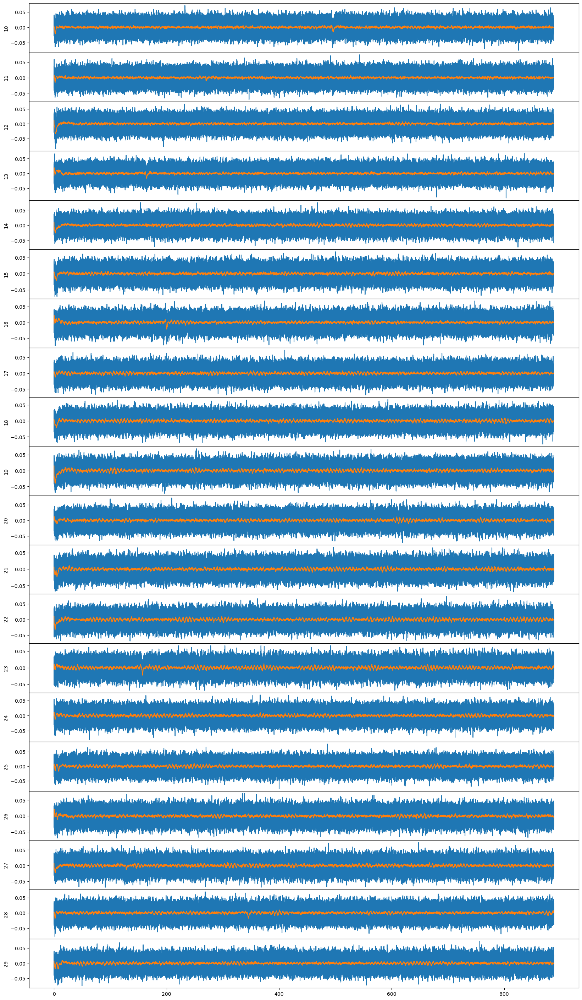

In [27]:
dic.keys()

phone = 44
fig,axs = plt.subplots(figsize=(20,18*2),nrows=20,sharex=True)
for i,ax in zip(range(10,30),axs):
    filename = datas[phone]['filelist'][i]
    data = rw.read_csv(filename,delimiter=',')
    dic = dataphone.read_raw(data,'a')
    
    t = dic['ta']
    y = dic['az']
    t = t-t[0]
    y = y-np.mean(y)
    ax.plot(t,y)
    y_high,y_wave,y_trend,err = analyse.filtering(y,fc=0.01,flow=0.0001)
    ax.plot(t,y_wave)    
    ax.set_ylabel(i)
fig.subplots_adjust(hspace=0)



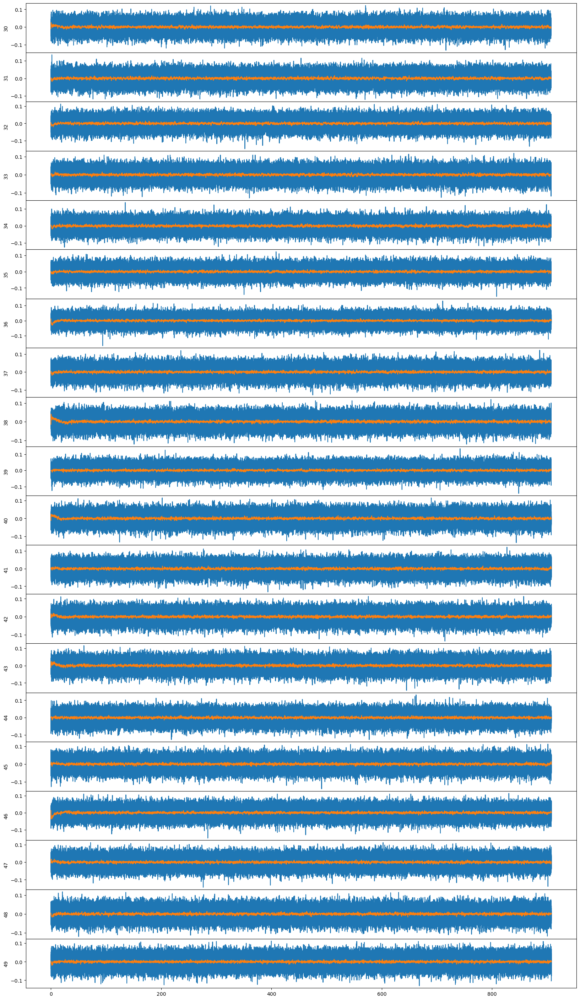

In [21]:
dic.keys()

phone = 56
fig,axs = plt.subplots(figsize=(20,18*2),nrows=20,sharex=True)
for i,ax in zip(range(30,50),axs):
    filename = datas[phone]['filelist'][i]
    data = rw.read_csv(filename,delimiter=',')
    dic = dataphone.read_raw(data,'a')
    
    t = dic['ta']
    y = dic['az']
    t = t-t[0]
    y = y-np.mean(y)
    ax.plot(t,y)
    y_high,y_wave,y_trend,err = analyse.filtering(y,fc=0.01,flow=0.0001)
    ax.plot(t,y_wave)    
    ax.set_ylabel(i)
fig.subplots_adjust(hspace=0)



In [23]:
len(datas[phone]['filelist'])

60

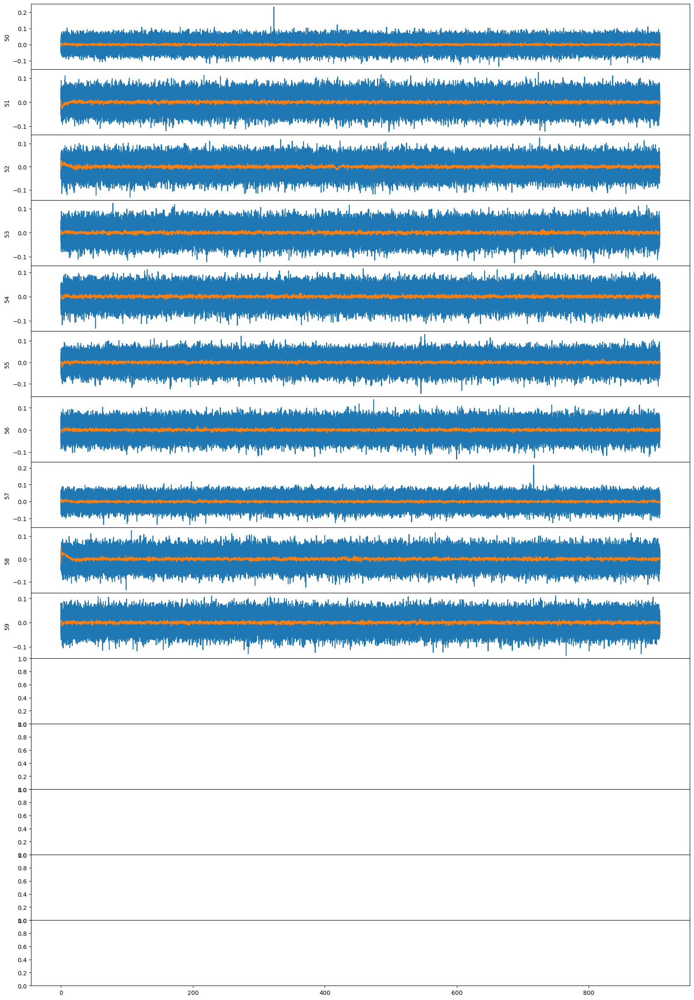

In [24]:
dic.keys()

phone = 56
n = 15
fig,axs = plt.subplots(figsize=(20,2*n),nrows=n,sharex=True)
for i,ax in zip(range(50,60),axs):
    filename = datas[phone]['filelist'][i]
    data = rw.read_csv(filename,delimiter=',')
    dic = dataphone.read_raw(data,'a')
    
    t = dic['ta']
    y = dic['az']
    t = t-t[0]
    y = y-np.mean(y)
    ax.plot(t,y)
    y_high,y_wave,y_trend,err = analyse.filtering(y,fc=0.01,flow=0.0001)
    ax.plot(t,y_wave)    
    ax.set_ylabel(i)
fig.subplots_adjust(hspace=0)



In [8]:
folder = base +f'Data/{date}/Phone/Tsync/'
filesync = folder + 'tsync_1738853637.txt'

synctable = rw.read_csv(filesync,delimiter=',')
synctable = rw.csv2dict(synctable)

timetable = {}
phonelist = []
#t0 = synctable['0_0']['t0']
for key in synctable:
    phone,i = key.split('_')
    phone = int(phone)
    if not phone in phonelist:
        phonelist.append(phone)
        timetable[phone]=[]
    timetable[phone].append(synctable[key]['tlag'])

for phone in phonelist:
    timetable[phone] = np.mean(timetable[phone])
pprint(timetable)

for phone in datas.keys():
    datas[phone]['tref']=timetable[phone]

['phone', 'iter', 'tlag', 'dtmedian', 'tmin', 'tmax', 'tstd', 'n', 't0']
['1_0', '1', '0', '1738848442.1988559', '0.0016173620000000002', '1738848442.1985602', '1738848442.1990857', '0.00011410136313866452', '50', '1738853574.0269525']
['2_0', '2', '0', '1738848449.881998', '0.001971494', '1738848449.8817668', '1738848449.8822184', '0.00010373140571608224', '50', '1738853574.6024015']
['3_0', '3', '0', '1738848475.0400636', '0.0020572010000000003', '1738848475.0398757', '1738848475.0402207', '9.749458993500487e-05', '50', '1738853575.367851']
['4_0', '4', '0', '1738848454.8003325', '0.0013606795000000002', '1738848454.8001194', '1738848454.800468', '8.524810911373303e-05', '50', '1738853576.676181']
['5_0', '5', '0', '1738848462.4320765', '0.001309538', '1738848462.4318838', '1738848462.4323432', '9.701380596400548e-05', '50', '1738853577.3308058']
['6_0', '6', '0', '1738848477.7166438', '0.001579368', '1738848477.7163386', '1738848477.7167535', '0.00012040892662358699', '50', '1738853

In [10]:
folder = base +f'Data/{date}/Phone/Tsync/'
filesync = folder + 'tsync_1738853637.txt'

synctable = rw.read_csv(filesync,delimiter=',')
synctable = rw.csv2dict(synctable)

timetable = {}
phonelist = []
#t0 = synctable['0_0']['t0']
for key in synctable:
    phone,i = key.split('_')
    phone = int(phone)
    if not phone in phonelist:
        phonelist.append(phone)
        timetable[phone]=[]
    timetable[phone].append(synctable[key]['tlag'])

for phone in phonelist:
    timetable[phone] = np.mean(timetable[phone])
pprint(timetable)

for phone in datas.keys():
    datas[phone]['tref']=timetable[phone]

['phone', 'iter', 'tlag', 'dtmedian', 'tmin', 'tmax', 'tstd', 'n', 't0']
['1_0', '1', '0', '1738848442.1988559', '0.0016173620000000002', '1738848442.1985602', '1738848442.1990857', '0.00011410136313866452', '50', '1738853574.0269525']
['2_0', '2', '0', '1738848449.881998', '0.001971494', '1738848449.8817668', '1738848449.8822184', '0.00010373140571608224', '50', '1738853574.6024015']
['3_0', '3', '0', '1738848475.0400636', '0.0020572010000000003', '1738848475.0398757', '1738848475.0402207', '9.749458993500487e-05', '50', '1738853575.367851']
['4_0', '4', '0', '1738848454.8003325', '0.0013606795000000002', '1738848454.8001194', '1738848454.800468', '8.524810911373303e-05', '50', '1738853576.676181']
['5_0', '5', '0', '1738848462.4320765', '0.001309538', '1738848462.4318838', '1738848462.4323432', '9.701380596400548e-05', '50', '1738853577.3308058']
['6_0', '6', '0', '1738848477.7166438', '0.001579368', '1738848477.7163386', '1738848477.7167535', '0.00012040892662358699', '50', '1738853

In [11]:
datas[1].keys()

dict_keys(['filelist', 'tref'])

In [12]:
phone = 1
tref = timetable[phone]

In [25]:
filename.split('-')

['/media/turbots/BlueDisk/Shack25_local/Data/0206/Phone/1/',
 '2025',
 '02',
 '06T09_54_22',
 'android.sensor.accelerometer',
 '1',
 '5220274749',
 '6107979002.csv']

In [13]:

m = {}

phonelist = [1,2,3]
for phone in phonelist:
    tref = timetable[phone]
    for filename in datas[phone]['filelist']: 
        if not phone in m.keys():
            m[phone]={}
        num = int(filename.split('-')[5])
        if num>11 and num<16:
            m[phone][num]={}
            dic = dataphone.load_data(filename)
            #print(phone,dic.keys())
            for key in dic.keys():
                m[phone][num][key]=dic[key]
            m[phone][num]['ta_s'] = dic['ta']+tref#-datas[phone]['tstart']
            print(phone,num,np.std(m[phone][num]['az']))

1 12 0.026115179297942943
1 13 0.01569181254586673
1 14 0.13647452460425696
1 15 0.01569837221069109
2 12 0.015532458167543032
2 13 0.01543074699450581
2 14 5.135541219084807
2 15 0.015523752382207323
3 12 0.015928977101334712
3 13 0.016248041207571232
3 14 7.116019383355022
3 15 3.926934314438052


In [44]:
import scipy.signal as sig

In [71]:
moy = np.mean(dic['az'])
sigma = np.std(dic['az'])

part = np.sum(np.abs(dic['az']-moy)<5*sigma)
print(part/len(dic['az']))

0.9997416666666666


In [73]:
m.keys()

dict_keys([1, 2, 3])

In [72]:
phone = 1
print(m[phone][num].keys())
print(phone,num)

KeyError: 79

In [ ]:
#local_time, phone, number, variable, tag, A_wave, f, GPS_phone, GPS_Garmin, filename


['12:36:54']
46230
['12:51:40']
46230
['12:37:02']
46230
['12:51:48']
46230
['12:37:03']
46230
['12:51:49']
46230
['12:36:54']
46230
['12:51:40']
46230
['12:37:02']
46230
['12:51:48']
46230
['12:37:03']
46230
['12:51:49']
46230
['12:36:54']
46230
['12:51:40']
46230
['12:37:02']
46230
['12:51:48']
46230
['12:37:03']
46230
['12:51:49']
46230


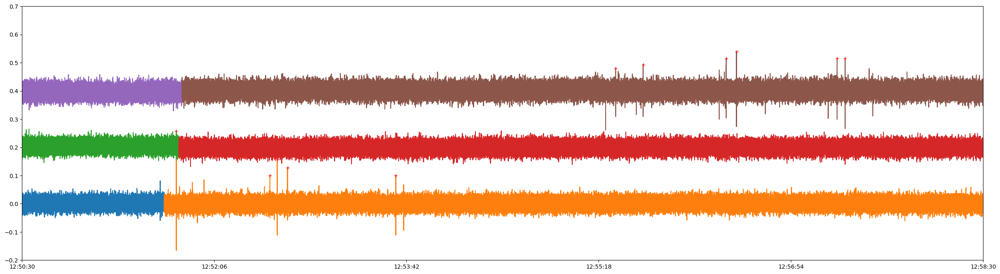

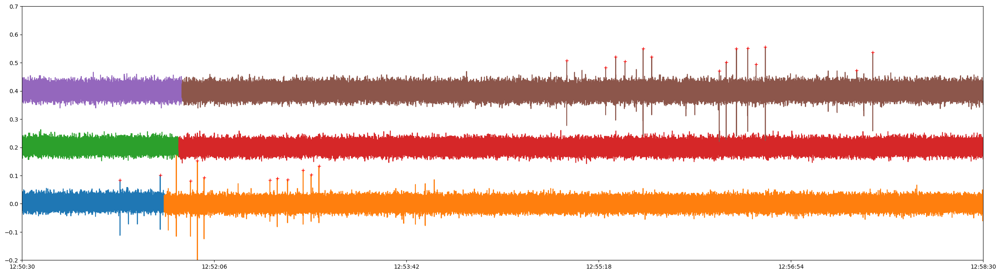

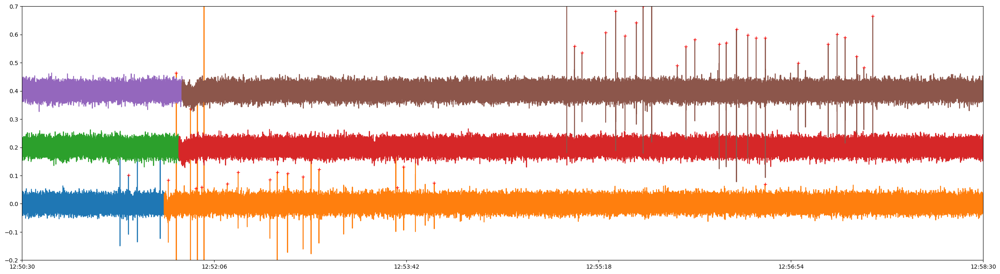

In [68]:
m.keys()

dic.keys()

indices = range(12,14)
n = len(indices)

for c in m[1][12]['coords']:
    fig,ax = plt.subplots(figsize=(30,8))

    for j,phone in enumerate(phonelist):
        for i in indices:
            dic = m[phone][i]
            t = dic['ta_s']
            t = t-t[0]+timest.today_time([t[0]])[0]

            y = dic['a'+c]
            y = y-np.mean(y)
            ax.plot(t,y+j/5)
    #        y_high,y_wave,y_trend,err = analyse.filtering(y,fc=0.01,flow=0.0001)

            print(timest.display_time([t[0]]))
            peaks,props = sig.find_peaks(y, prominence=0.15,distance=200)

            ax.plot(t[peaks],y[peaks]+j/5,'r+')        
            tmin = multi.convert_time('12:50:30')
            tmax = multi.convert_time('12:58:30')
            plt.xlim([tmin,tmax])
            #plt.xlim([46501.95,46502.1])
            #plt.xlim([46586.7,46586.9])
            #plt.xlim([46526.4,46526.5])
            ticks = np.linspace(tmin,tmax,6)
            ax.set_xticks(ticks,timest.display_time(ticks))

            print(tmin)
            ax.set_ylim(-0.2,0.7)
            #ax.set_xlim(100,200)                



In [37]:
22.5/(1/400*4)

2250.0

In [20]:
45/(1/400*15)

1200.0

['05:56:33']


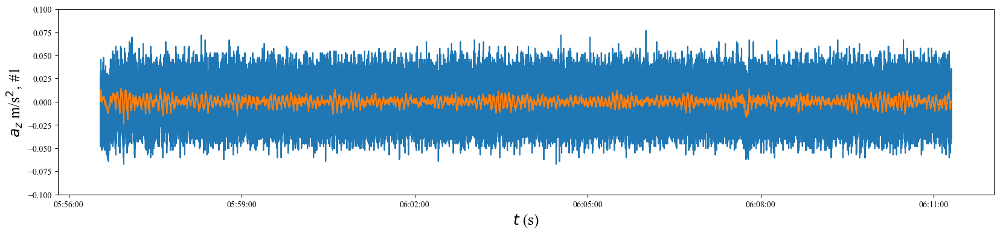

In [31]:
import icewave.field.time as timest


fig,ax = plt.subplots(figsize=(20,4))

phone = 1
num = 34
dic = m[num]

t = dic['ta_s']
y = dic['az']
y = y-np.mean(y)
y_high,y_wave,y_trend,err = analyse.filtering(y,fc=0.01,flow=0.0001)


t = t-t[0]+timest.today_time([t[0]])[0]
print(timest.display_time([t[0]]))

ax.plot(t,y)
ax.plot(t,y_wave)

tmin = multi.convert_time('5:56:00')
tmax = multi.convert_time('6:11:00')
#plt.xlim([tmin,tmax])

ticks = np.linspace(tmin,tmax,6)
ax.set_xticks(ticks,timest.display_time(ticks))


ax.set_ylim(-0.1,0.1)
ylabel = '$a_z$ m/s$^2$, #'+str(phone)
figs = graphes.legende('$t$ (s)',ylabel,'',ax=ax)

#graphes.save_figs(figs,savedir=savefolder,prefix='12phones_exemple_')

21
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/21/accelerometer-21-85155494842-86036301309.csv
['19:03:26']
22
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/22/accelerometer-21-80818224587-81702886518.csv
['19:04:44']
23
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/23/accelerometer-21-85295878845-86181334609.csv
['19:05:00']
24
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/24/accelerometer-21-85308196950-86192942637.csv
['19:04:44']
25
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/25/accelerometer-21-85420308321-86309515119.csv
['19:06:19']
26
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/26/accelerometer-21-85443806293-86332959299.csv
['19:06:25']
27
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/27/accelerometer-21-85420169348-86305717838.csv
['19:05:04']
28
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/28/accelerometer-21-85511959620-86400502255.csv
['19:06:07']
29
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone

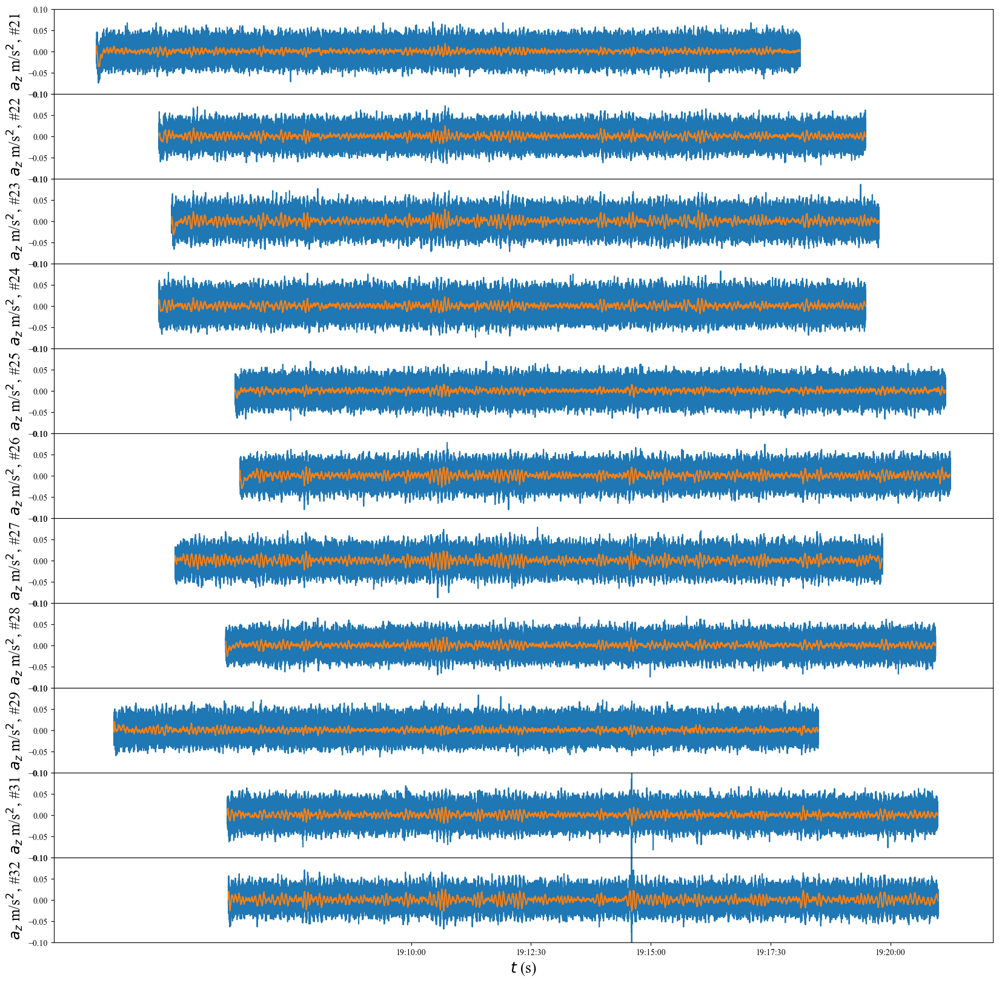

In [72]:
filename = selectfiles[5]

n = len(datas.keys())
fig,axs = plt.subplots(figsize=(20,20),nrows=n,sharex=True)

for ax,phone in zip(axs,datas.keys()):
    print(phone)
    filename = datas[phone]['filelist'][5]
    print(filename)
    dic = datas[phone]

    t = dic['ta_s']
    y = dic['az']

    y = y-np.mean(y)
    y_high,y_wave,y_trend,err = analyse.filtering(y,fc=0.01,flow=0.0001)
    t = t-t[0]+timest.today_time([t[0]])[0]

    ax.plot(t,y)
    ax.plot(t,y_wave)
    #ax.set_xlim(410,480)
    ax.set_ylim(-0.1,0.1)
    ylabel = '$a_z$ m/s$^2$, #'+str(phone)
    figs = graphes.legende('',ylabel,'',ax=ax)
    
    print(timest.display_time([t[0]]))

    tmin = multi.convert_time('19:10:00')
    tmax = multi.convert_time('19:20:00')
    #plt.xlim([tmin,tmax])

    ticks = np.linspace(tmin,tmax,5)
    ax.set_xticks(ticks,timest.display_time(ticks))


fig.subplots_adjust(hspace=0)
figs = graphes.legende('$t$ (s)',ylabel,'',ax=ax)

#graphes.save_figs(figs,savedir=savefolder,prefix='12phones_exemple_')

0.0025000000023283064
21
['19:03:26']
245309
22
['19:04:44']
244246
23
['19:05:00']
244024
24
['19:04:44']
244222
25
['19:06:19']
242988
26
['19:06:25']
243014
27
['19:05:04']
243993
28
['19:06:07']
243176
29
['19:03:48']
245026
31
['19:06:09']
242999
32
['19:06:11']
243154


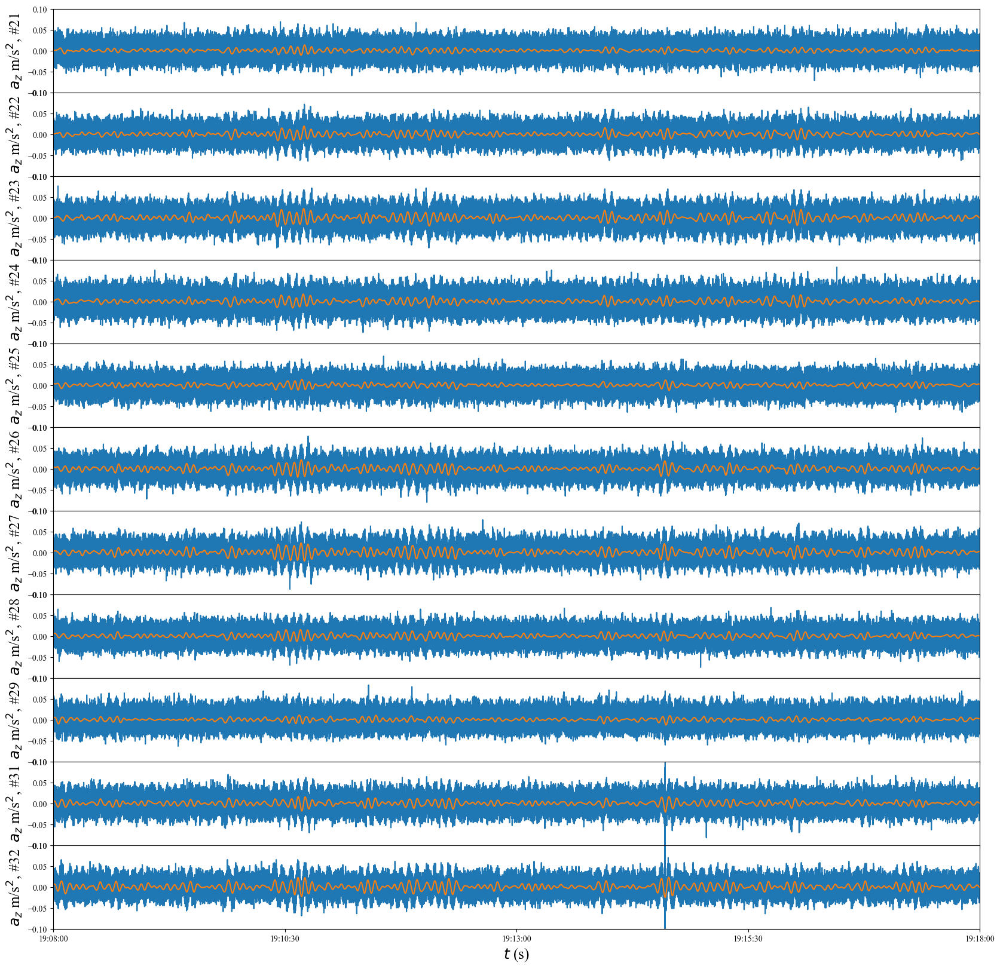

In [95]:
filename = selectfiles[5]

n = len(datas.keys())
fig,axs = plt.subplots(figsize=(20,20),nrows=n,sharex=True)

N = 240001
Z = np.zeros((n,N))
Zf = np.zeros((n,N))


tmin = multi.convert_time('19:08:00')
tmax = multi.convert_time('19:18:00')
ti = np.linspace(tmin,tmax,N)
print(np.diff(ti)[0])

for i,(ax,phone) in enumerate(zip(axs,datas.keys())):
    print(phone)
    dic = datas[phone]
    t = dic['ta_s']
    y = dic['az']

    y = y-np.mean(y)
    y_high,y_wave,y_trend,err = analyse.filtering(y,fc=0.002,flow=0.0001)
    t = t-t[0]+timest.today_time([t[0]])[0]

    ax.plot(t,y)
    ax.plot(t,y_wave)
    
    f = interp.interp1d(t, y, kind='cubic')
    yi = f(ti)
    Z[i,:]=yi
    
    ff = interp.interp1d(t, y_wave, kind='cubic')
    yi = ff(ti)
    Zf[i,:]=yi
    
    #ax.set_xlim(410,480)
    ax.set_ylim(-0.1,0.1)
    ylabel = '$a_z$ m/s$^2$, #'+str(phone)
    figs = graphes.legende('',ylabel,'',ax=ax)
    
    print(timest.display_time([t[0]]))

    plt.xlim([tmin,tmax])

    ticks = np.linspace(tmin,tmax,5)
    ax.set_xticks(ticks,timest.display_time(ticks))

    eps = 0.1
    indices = np.logical_and(t>=tmin-eps,t<=tmax+eps)
    print(np.sum(indices))
fig.subplots_adjust(hspace=0)
figs = graphes.legende('$t$ (s)',ylabel,'',ax=ax)

#graphes.save_figs(figs,savedir=savefolder,prefix='12phones_exemple_')

(50000.0, 100000.0)

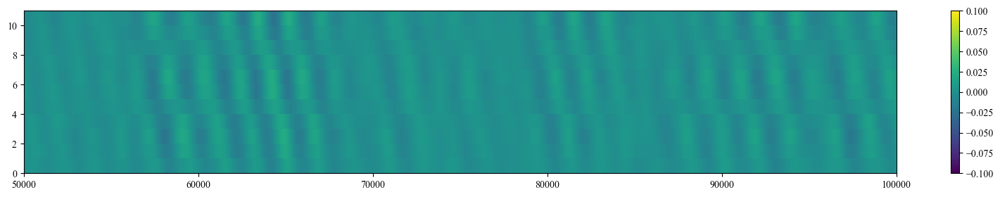

In [111]:
fig,ax=plt.subplots(figsize=(20,3))
plt.pcolormesh(Zf,vmin=-0.1,vmax=0.1)
plt.colorbar()
plt.xlim(50000,100000)

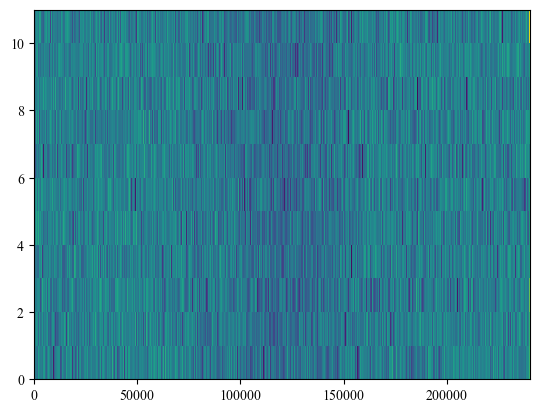

In [92]:
Tf = np.fft.fft2(Zf)

plt.pcolormesh(np.abs(np.log10(Tf)))

21
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/21/accelerometer-21-85155494842-86036301309.csv
21 9.799011919000002 0.013495793643253736 0.016240978110665202 0.014935406147191117
['19:03:26']
22
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/22/accelerometer-21-80818224587-81702886518.csv
22 9.727643039391669 0.01459117925802579 0.014540940907803777 0.014967028434082378
['19:04:44']
23
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/23/accelerometer-21-85295878845-86181334609.csv
23 9.811913996349997 0.015915606534955887 0.017006945494269086 0.016662263503136914
['19:05:00']
24
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/24/accelerometer-21-85308196950-86192942637.csv
24 9.807181081327775 0.016030738851429784 0.019793150659926817 0.01705228101048879
['19:04:44']
25
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/25/accelerometer-21-85420308321-86309515119.csv
25 9.879901644188886 0.012622398057976618 0.018668420938894044 0.01530608857868747
['19:0

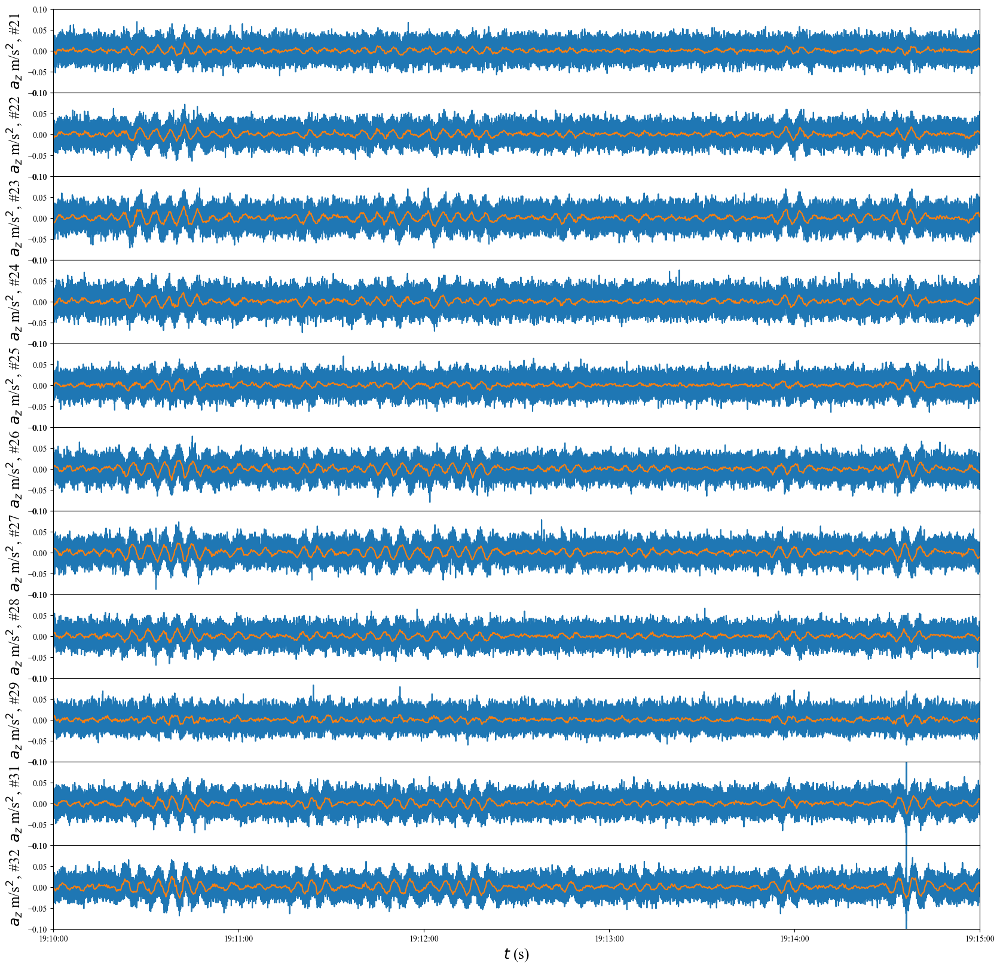

In [64]:
filename = selectfiles[5]

n = len(datas.keys())
fig,axs = plt.subplots(figsize=(20,20),nrows=n,sharex=True)

for ax,phone in zip(axs,datas.keys()):
    print(phone)
    filename = datas[phone]['filelist'][5]
    print(filename)
    dic = dataphone.load_data(filename)

    print(phone,np.mean(dic['az']),np.std(dic['ax']),np.std(dic['ay']),np.std(dic['az']))
    t = dic['ta']+datas[phone]['tref']#-datas[phone]['tstart']
    y = dic['az']
    y = y-np.mean(y)
    y_high,y_wave,y_trend,err = analyse.filtering(y,fc=0.01,flow=0.0001)
    t = t-t[0]+timest.today_time([t[0]])[0]

    ax.plot(t,y)
    ax.plot(t,y_wave)
    #ax.set_xlim(410,480)
    ax.set_ylim(-0.1,0.1)
    ylabel = '$a_z$ m/s$^2$, #'+str(phone)
    figs = graphes.legende('',ylabel,'',ax=ax)
    
    print(timest.display_time([t[0]]))

    tmin = multi.convert_time('19:10:00')
    tmax = multi.convert_time('19:15:00')
    plt.xlim([tmin,tmax])

    ticks = np.linspace(tmin,tmax,6)
    ax.set_xticks(ticks,timest.display_time(ticks))


fig.subplots_adjust(hspace=0)
figs = graphes.legende('$t$ (s)',ylabel,'',ax=ax)

#graphes.save_figs(figs,savedir=savefolder,prefix='12phones_exemple_')

21
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/21/accelerometer-21-85155494842-86036301309.csv
21 9.799011919000002 0.013495793643253736 0.016240978110665202 0.014935406147191117
['19:03:26']
22
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/22/accelerometer-21-80818224587-81702886518.csv
22 9.727643039391669 0.01459117925802579 0.014540940907803777 0.014967028434082378
['19:04:44']
23
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/23/accelerometer-21-85295878845-86181334609.csv
23 9.811913996349997 0.015915606534955887 0.017006945494269086 0.016662263503136914
['19:05:00']
24
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/24/accelerometer-21-85308196950-86192942637.csv
24 9.807181081327775 0.016030738851429784 0.019793150659926817 0.01705228101048879
['19:04:44']
25
/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/25/accelerometer-21-85420308321-86309515119.csv
25 9.879901644188886 0.012622398057976618 0.018668420938894044 0.01530608857868747
['19:0

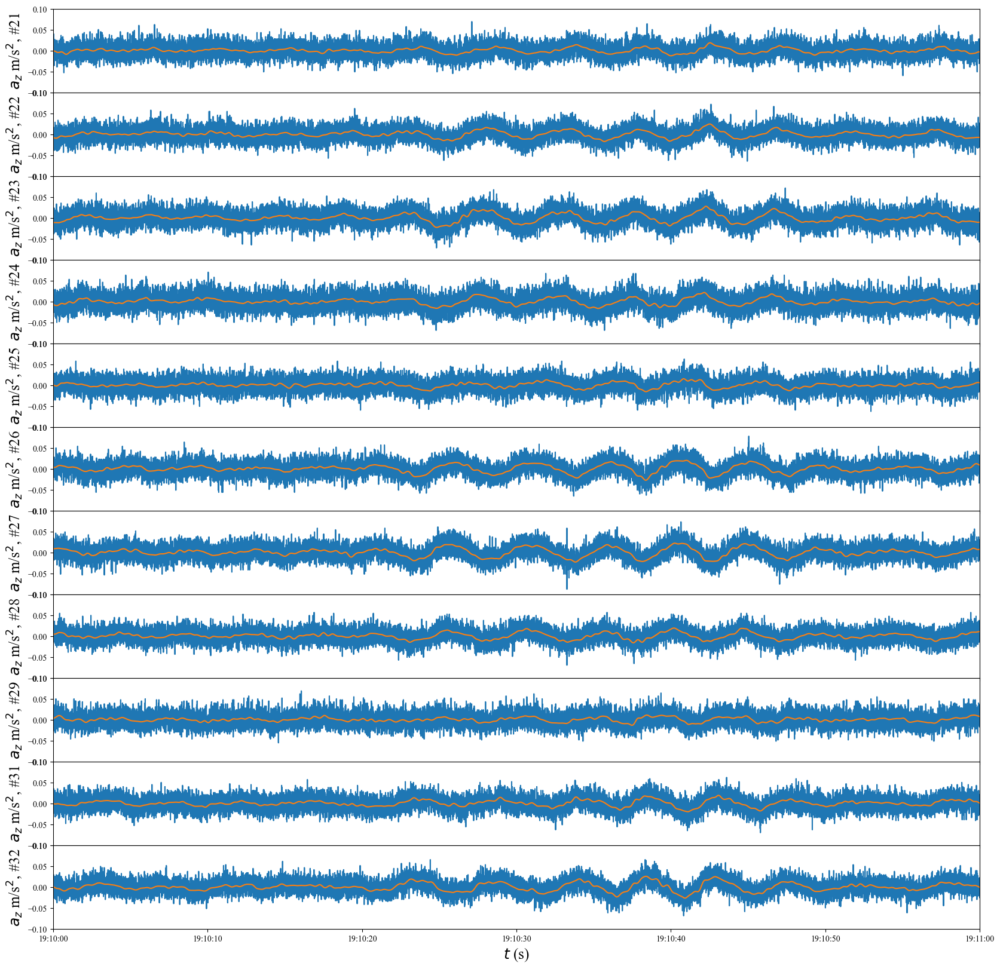

In [63]:
filename = selectfiles[5]

n = len(datas.keys())
fig,axs = plt.subplots(figsize=(20,20),nrows=n,sharex=True)

for ax,phone in zip(axs,datas.keys()):
    print(phone)
    filename = datas[phone]['filelist'][5]
    print(filename)
    dic = dataphone.load_data(filename)

    print(phone,np.mean(dic['az']),np.std(dic['ax']),np.std(dic['ay']),np.std(dic['az']))
    t = dic['ta']+datas[phone]['tref']#-datas[phone]['tstart']
    y = dic['az']
    y = y-np.mean(y)
    y_high,y_wave,y_trend,err = analyse.filtering(y,fc=0.01,flow=0.0001)
    t = t-t[0]+timest.today_time([t[0]])[0]

    ax.plot(t,y)
    ax.plot(t,y_wave)
    #ax.set_xlim(410,480)
    ax.set_ylim(-0.1,0.1)
    ylabel = '$a_z$ m/s$^2$, #'+str(phone)
    figs = graphes.legende('',ylabel,'',ax=ax)
    
    print(timest.display_time([t[0]]))

    tmin = multi.convert_time('19:10:00')
    tmax = multi.convert_time('19:11:00')
    plt.xlim([tmin,tmax])

    ticks = np.linspace(tmin,tmax,7)
    ax.set_xticks(ticks,timest.display_time(ticks))


fig.subplots_adjust(hspace=0)
figs = graphes.legende('$t$ (s)',ylabel,'',ax=ax)

#graphes.save_figs(figs,savedir=savefolder,prefix='12phones_exemple_')

In [14]:
filename = '/media/turbots/BlueDisk/Shack25_local/Data/0203/Phone/21/accelerometer-16-80751610879-81632408797.csv'

data = rw.read_csv(filename,delimiter=',')



[['ta', 'ax', 'ay', 'az'],
 ['80751610879.0', '0.33405003', '-0.19695', '9.79605'],
 ['80751613326.0', '0.34605002', '-0.18300001', '9.77505'],
 ['80751615773.0', '0.33900002', '-0.15900001', '9.79605'],
 ['80751618220.0', '0.351', '-0.18705001', '9.79605'],
 ['80751620667.0', '0.35295', '-0.15405001', '9.780001'],
 ['80751623114.0', '0.33405003', '-0.171', '9.790951'],
 ['80751625561.0', '0.32205', '-0.18', '9.7890005'],
 ['80751628007.0', '0.31500003', '-0.15105', '9.7890005'],
 ['80751630454.0', '0.32205', '-0.156', '9.8230505'],
 ['80751632901.0', '0.33705002', '-0.14400001', '9.82695'],
 ['80751635348.0', '0.33405003', '-0.17295001', '9.79605'],
 ['80751637794.0', '0.31995', '-0.13995', '9.78195'],
 ['80751640241.0', '0.32205', '-0.135', '9.772051'],
 ['80751642688.0', '0.31305', '-0.18300001', '9.80595'],
 ['80751645134.0', '0.33', '-0.18300001', '9.79905'],
 ['80751647581.0', '0.33705002', '-0.15405001', '9.790951'],
 ['80751650028.0', '0.37305', '-0.16095', '9.802951'],
 ['8075

21 9.798486502520834 0.013220838318506215 0.014362392525235967 0.014458625863165347


(0.0, 900.0)

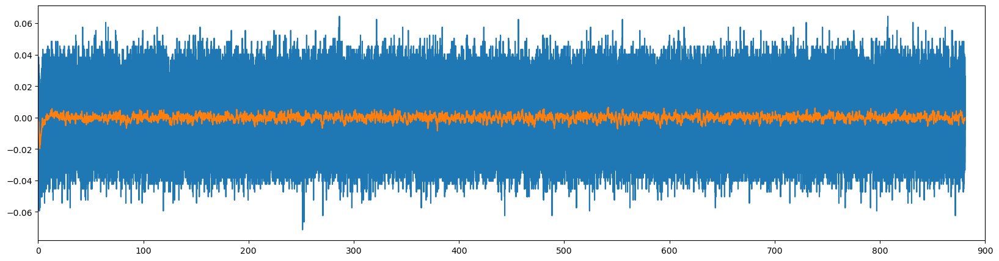

In [47]:
dic = rw.csv2dict(data)

fig,ax = plt.subplots(figsize=(20,5))

phone = 21
coords = ['x','y','z']
T = np.asarray(dic['ta']).astype(float)/10**6
for c in coords:
    dic['a'+c] = np.asarray(dic['a'+c]).astype(float)
dic['ta']=T
print(phone,np.mean(dic['az']),np.std(dic['ax']),np.std(dic['ay']),np.std(dic['az']))

t = dic['ta']-dic['ta'][0]
y = dic['az']
y = y-np.mean(y)
y_high,y_wave,y_trend,err = analyse.filtering(y,fc=0.01,flow=0.00005)

plt.plot(t,y)
plt.plot(t,y_wave)
plt.xlim(0,900)

21 9.799011919000002 0.013495793643253736 0.016240978110665202 0.014935406147191117


(0.0, 900.0)

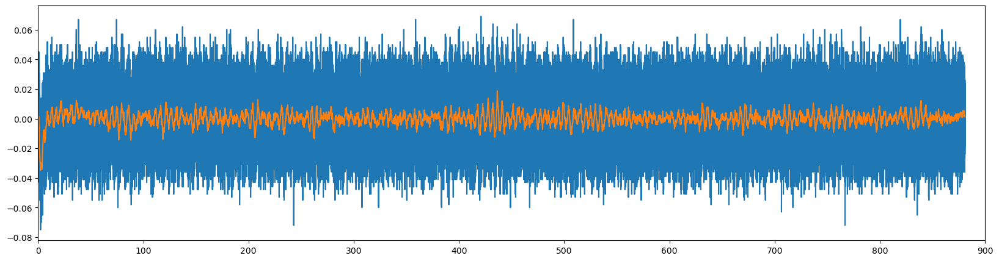

In [39]:
dic = rw.csv2dict(data)

fig,ax = plt.subplots(figsize=(20,5))

phone = 21
coords = ['x','y','z']
T = np.asarray(dic['ta']).astype(float)/10**6
for c in coords:
    dic['a'+c] = np.asarray(dic['a'+c]).astype(float)
dic['ta']=T
print(phone,np.mean(dic['az']),np.std(dic['ax']),np.std(dic['ay']),np.std(dic['az']))

t = dic['ta']-dic['ta'][0]
y = dic['az']
y = y-np.mean(y)
y_high,y_wave,y_trend,err = analyse.filtering(y,fc=0.01,flow=0.00005)

plt.plot(t,y)
plt.plot(t,y_wave)
plt.xlim(0,900)

In [25]:
base = '/media/turbots/BlueDisk/Shack25_local/'

date = '0203'
phone = 21

folder = base +f'Data/{date}/Phone/{phone}/'
filelist = glob.glob(folder+'accelerometer*')

m={}
datas = []
coords = ['x','y','z']
print(phone)
for i,filename in enumerate(filelist):
    data = rw_data.read_csv(filename)
    dic = rw_data.csv2dict(data)

    Tsync = np.asarray(dic['ta']).astype(float)/10**6
    for c in coords:
        dic['a'+c] = np.asarray(dic['a'+c]).astype(float)
    dic['ta']=Tsync
    datas.append(dic)
    print(i,np.mean(dic['az']),np.std(dic['ax']),np.std(dic['ay']),np.std(dic['az']))

m[phone]=datas

21
0 -9.739978754221852 1.5859244102692547 0.8238315043205189 1.1482797847190476
1 -6.296558048843816 1.3056261141898542 1.0425320419238346 7.6423533509750134
2 9.805712567970835 0.014826869826586231 0.015452095519775243 0.01558529753133427
3 9.801961441148611 0.013543516062503546 0.014745179364217395 0.014765296115934015
4 9.800172915965277 0.013397401954427337 0.014577704585593649 0.014670431217854281
5 9.799312060272221 0.013344988996861873 0.014505799596604859 0.014647279369613957
6 9.798853929718055 0.013297570173758126 0.01456726598553946 0.014584402359782388
7 9.798204358276386 0.013267640798847919 0.014528249087347497 0.014537078716273522
8 9.797926578416664 0.01329169309109514 0.014574657878702732 0.014506022423545484
9 9.797675997065278 0.013240203756538987 0.01447575400843413 0.014443008490969378
10 9.797814074834722 0.01322284241935437 0.014421725538352389 0.01443467793825798
11 9.798004596981944 0.013227475125825052 0.014420336504041054 0.014469953995120858
12 9.7982351884

In [238]:
(46164333993 - 45264457287) / 1e6

899.876706

In [240]:
line = [62_0,62,0,1738374191.7004647,0.0016140165,1738374191.7001886,1738374191.7006545,0.00010423412695245264,50,1738419222.6897173]


In [8]:
filename = '/home/turbots/Documents/Bicwin2025/Data/0201/Phone/Tsync/tsync_1738419342'

synctable = rw.read_csv(filename,delimiter=',')
synctable = rw.csv2dict(synctable)

timetable = {}
phonelist = []
t0 = synctable['0_0']['t0']
for key in synctable:
    phone,i = key.split('_')
    phone = int(phone)
    if not phone in phonelist:
        phonelist.append(phone)
        timetable[phone]=[]
    timetable[phone].append(synctable[key]['tlag'])

for phone in phonelist:
    timetable[phone] = np.mean(timetable[phone])
pprint(timetable)


['phone', 'iter', 'tlag', 'dtmedian', 'tmin', 'tmax', 'tstd', 'n', 't0']
['0_0', '0', '0', '1738418902.17872', '0.0017045665000000002', '1738418902.178598', '1738418902.1789145', '8.235415340473988e-05', '50', '1738419211.7666726']
['2_0', '2', '0', '1737121520.0597029', '0.0019856120000000003', '1737121520.059486', '1737121520.0603476', '0.0002442747616601099', '49', '1738419215.6008306']
['3_0', '3', '0', '1737224618.0504465', '0.0015850695', '1737224618.0502918', '1737224618.05061', '8.657121420764143e-05', '50', '1738419216.0741687']
['4_0', '4', '0', '1738326732.6696436', '0.0013847445', '1738326732.6695323', '1738326732.6697898', '6.391023367422995e-05', '50', '1738419216.3749998']
['5_0', '5', '0', '1737224626.3721771', '0.001748416', '1737224626.371911', '1737224626.3723445', '0.00010209110283137354', '50', '1738419216.8343472']
['6_0', '6', '0', '1738325426.5916772', '0.0024526540000000003', '1738325426.5914388', '1738325426.5918677', '0.00011886205646892161', '50', '173841921

In [37]:
base = '/home/turbots/Documents/Bicwin2025'

date = '0201'
phonelist = [58,59,62]

m={}
for phone in phonelist:
    folder = base +f'/Data/{date}/Phone/{phone}/'

    filelist = glob.glob(folder+'accelerometer*')

    datas = []
    coords = ['x','y','z']
    print(phone)
    for i,filename in enumerate(filelist):
        data = rw_data.read_csv(filename)
        dic = rw_data.csv2dict(data)

        Tsync = np.asarray(dic['ta']).astype(float)/10**6+timetable[phone]
        for c in coords:
            dic['a'+c] = np.asarray(dic['a'+c]).astype(float)
        dic['ta']=Tsync
        datas.append(dic)
        print(i,np.mean(dic['az']),np.std(dic['ax']),np.std(dic['ay']),np.std(dic['az']))

    m[phone]=datas

58
0 10.063960387447407 0.530202014467021 0.5681384908236368 0.6505255424201313
1 10.059912209967749 0.5059350894891376 0.4684573913752614 0.7343026593421924
2 10.055798189612768 0.5959808534517915 0.674530496303014 0.9865336962474915
3 10.069785738170554 0.027867157024921596 0.031222801883774326 0.047021598315528955
4 10.038900483351114 0.02675521221039196 0.0264194512943902 0.04564835095937934
5 10.0295872151375 0.010532648518201883 0.028323020496084556 0.038595120864343684
6 8.022010042423162 1.6964267042694803 1.3615335882167026 5.572657196245988
7 9.975412584075002 0.008124667453223586 0.023263685386302253 0.024382439676122893
8 9.974803898887497 0.007848930536925773 0.023158926177292878 0.024379097192035497
9 9.975808902766666 0.007824082000997398 0.02311969598130629 0.024122542665417693
10 9.978191296359723 0.0078334199625825 0.023297048074617625 0.024082138543997
11 9.980082592910552 0.007949710111002343 0.022816097569316365 0.0258798629398286
12 9.981387557430555 0.00786673438

23 9.860315361154166 0.007177817557347706 0.0072589027681530735 0.023020729548349366
24 9.850123633030556 0.007244856999058836 0.00729501129414547 0.023497059613032504
25 9.84904962100833 0.007212476694686322 0.007342188401166861 0.023176346420547122
26 9.850457485061114 0.00726364184972786 0.008030164008316862 0.023102954044736824
27 9.850529715448612 0.007247891030015424 0.0074017401824706406 0.02310762263272566
28 9.850614797343054 0.007193886594366003 0.00735750287338182 0.02316349771563618
29 9.850947812538891 0.007225591029624856 0.0073658628489180105 0.02323792520999753


In [11]:
m.keys()

dict_keys([58, 59, 62])

In [45]:
54000/3600

15.0

In [ ]:
import icewave.field.time as timest
import icewave.phone.analyse as analyse

phone = 59
datas = m[phone]
fig,axs = plt.subplots(figsize=(20,15),nrows=3,sharex=True)

for i in range(len(datas)):
    print(i)
    dic = datas[i]
    ta = (np.asarray(dic['ta']).astype(float))#time in second, UTC time
    ta = ta-ta[0]+timest.today_time([ta[0]])[0]

    for i,c in enumerate(coords):
        y = dic['a'+c]
        y = y-np.mean(y)
        axs[i].plot(ta,y)
        y_high,y_wave,y_trend,err = analyse.filtering(y,fc=0.002,flow=0.0001)
        axs[i].plot(ta,y_wave*10,'k')
    
    print(timest.display_time([ta[0]]))
figs = graphes.legende('','$a_x$','',ax=axs[0])
figs = graphes.legende('','$a_y$','',ax=axs[1])
figs = graphes.legende('$t$ (s)','$a_z$','',ax=axs[2])
fig.subplots_adjust(hspace=0)

import icewave.field.multi_instruments as multi

#tmin = multi.convert_time('20:08:00')
#tmax = multi.convert_time('20:13:00')
plt.xlim([tmin,tmax])

ticks = np.linspace(tmin,tmax,6)
axs[2].set_xticks(ticks,display_time(ticks))


0
['09:17:34']
1
['09:32:48']
2
['09:48:02']
3
['10:03:17']
4
['10:18:32']
5
['10:33:48']
6
['10:49:05']
7
['11:04:21']
8
['11:19:39']
9
['11:34:57']
10
['11:50:16']
11
['12:05:33']
12
['12:20:50']
13
['12:36:07']
14
['12:51:24']
15
['13:06:40']
16
['13:21:57']
17
['13:37:14']
18
['13:52:30']
19
['14:07:46']
20
['14:23:03']
21
['14:38:19']
22
['14:53:36']
23
['15:08:53']
24
['15:24:09']
25
['15:39:26']
26
['15:54:43']
27
['16:10:01']
28
['16:25:18']
29
['16:40:37']
30
['16:55:55']
31
['17:11:14']
32
['17:26:33']
33
['17:41:52']
34
['17:57:10']
35
['18:12:29']
36
['18:27:48']
37
['18:43:07']
38
['18:58:26']
39
['19:13:45']


NameError: name 'tmin' is not defined

55.12491281617355

In [241]:
(line[3]-line[-1])

-45030.98925256729

In [223]:
45264457287 / 1e6 / 60 / 24

31.43365089375

In [218]:
46164333993 / 1e6

46164.333993

In [184]:
ts_20230629T064613 = 1688021173

In [187]:
1738532096 - ts_20230629T064613

50510923

In [207]:
ts_20230629T064613 + 53_365_417_168 / 1e6

1688074538.417168

In [204]:
np.ediff1d(np.array(_t[1:], dtype=float)[:, 0])

array([2514., 2514., 2514., ..., 2514., 2513., 2514.])

In [239]:
!ls /home/turbots/Documents/Bicwin2025/Data/0201/Phone

5  58  59  60  61  62  Results	Tsync


In [40]:
#!ls /home/turbots/Documents/Bicwin2025/Data/0201/Phone/62

In [41]:
#!cat /home/turbots/Documents/Bicwin2025/Data/0201/Phone/Tsync/tsync_1738418744

In [79]:
m={}

In [160]:
filelist[0]

'/home/turbots/Documents/Bicwin2025/Data/0201/Phone/62/accelerometer-1-45264457287-46164333993.pkl'

In [165]:
46164333993/10**6

46164.333993

In [162]:
dic['ta'][0]

76408332309.0

In [14]:
dic = rw_data.csv2dict(data)

In [157]:
np.mean(np.diff(dic['ta'][:10]))/1000

2.5525555555555557

76408332.309

In [159]:
dic['ta'][0]/1000/3600/24/365/

SyntaxError: invalid syntax (2517116250.py, line 1)

In [27]:
ta = timest.today_time(dic['ta'])
print(ta[:10])
print(len(ta))

[52131.6138, 54683.6138, 57235.6138, 59788.6138, 62340.6138, 64892.6138, 67445.6138, 69998.6138, 72552.6138, 75104.6138]
360000


In [36]:
dic['ta']/10**6

array([68048.79747461, 68048.80002161, 68048.80256861, ...,
       68965.48664961, 68965.48919561, 68965.49174161])

In [31]:
ta = (np.asarray(dic['ta']).astype(float))
ta = ta-ta[0]+timest.today_time([ta[0]])[0]


In [33]:
print(type(ta[0]))

<class 'numpy.float64'>


22
23


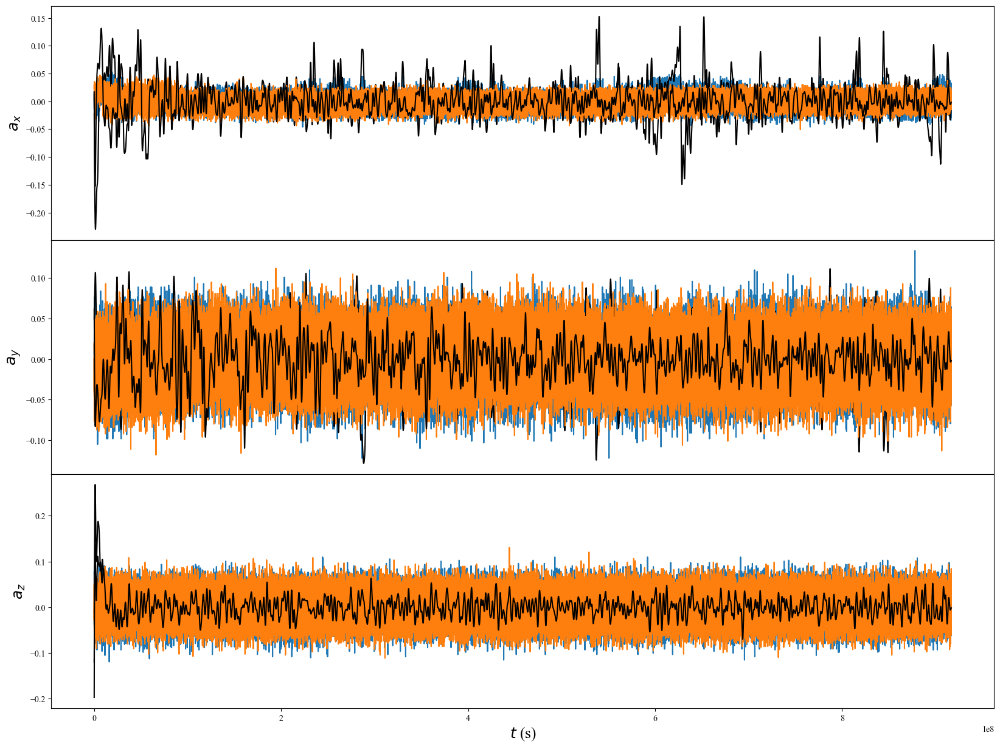

In [132]:
#19h12 UTC
#
line = [58_0,58,0,1738413622.0215788,0.0019006895,1738413622.021405,1738413622.0217085,8.651058798935326e-05,50,1738419220.7759938]

In [138]:
line1 = [0_0,0,0,1738418902.17872,0.0017045665000000002,1738418902.178598,1738418902.1789145,8.235415340473988e-05,50,1738419211.7666726]
print(line1)
line1[3]-line1[-1]

[0, 0, 0, 1738418902.17872, 0.0017045665000000002, 1738418902.178598, 1738418902.1789145, 8.235415340473988e-05, 50, 1738419211.7666726]


-309.58795261383057

In [140]:
Dt = line[-1]-line[3]
print(Dt)

5598.754415035248


In [135]:
import icewave.field.time as timest

t0 = [1738413622.0207553]
timest.display_time(timest.today_time(t0))

line[3]-line[-1]

['07:40:22']

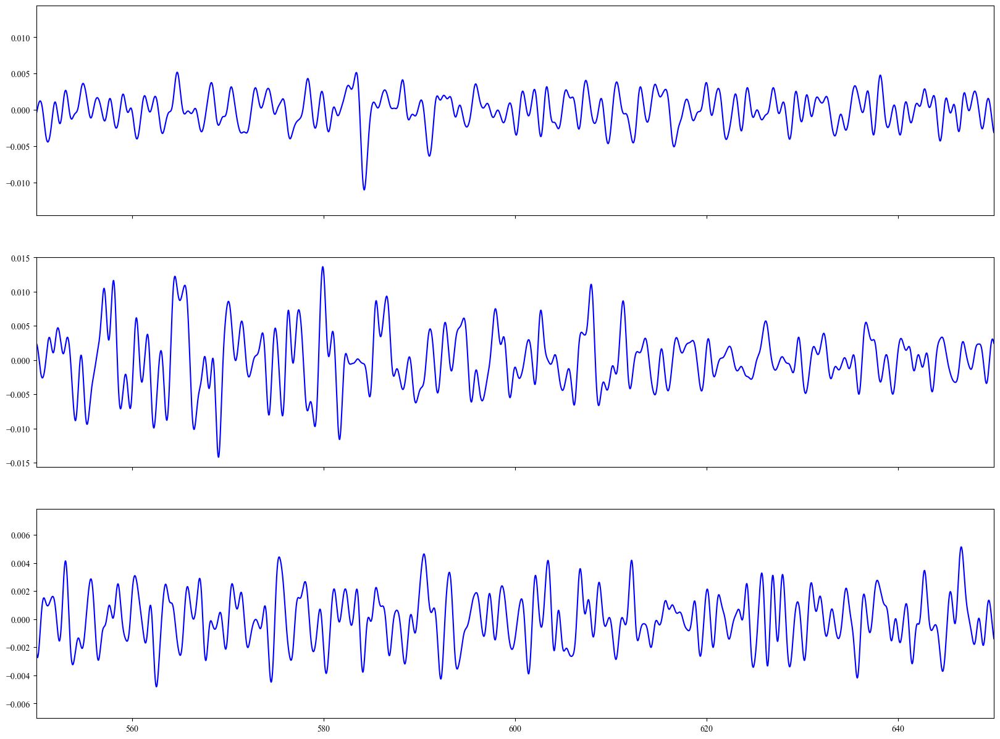

In [123]:
phonelist = [58,59,62]

fig,axs = plt.subplots(figsize=(20,15),nrows=3,sharex=True)


for i,phone in enumerate(phonelist):
    datas = m[phone]
    dic = datas[25]
    ta = np.asarray(dic['ta']).astype(float)
    az = np.asarray(dic['az']).astype(float)
    ax = np.asarray(dic['ax']).astype(float)
    ay = np.asarray(dic['ay']).astype(float)

    t = (ta-ta[0])/10**6
    #plt.plot(t,ax-np.mean(ax),'k-')

    import icewave.phone.analyse as analyse

    y_high,y_wave,y_trend,err = analyse.filtering(ax,fc=0.005,flow=0.0005)

    g=9.81
    axs[i].plot(t,y_wave,'b-')
    #plt.plot(t,y_high,'b-')

    plt.xlim(550,650)

In [124]:
np.std(ax)

0.007212476694686322

In [57]:
analyse.time_spectrum(ta,ax,nt=300)

Number of samples : 1200


(array([0.00000000e+00, 1.43838747e-07, 2.87677494e-07, ...,
        1.93750792e-04, 1.93894631e-04, 1.94038469e-04]),
 array([5.420107  , 5.40387426, 5.33796757, ..., 0.15912128, 0.15571553,
        0.15249032]),
 1.4383874682959443e-06,
 3.449465300488065)

In [36]:

base = '/home/turbots/Documents/Bicwin2025'

date = '0201'
phone = 59
folder = base +f'/Data/{date}/Phone/{phone}/'

filelist = glob.glob(folder+'accelerometer*')
pprint(filelist)

['/home/turbots/Documents/Bicwin2025/Data/0201/Phone/59/accelerometer-1-45231831847-46145821871.pkl',
 '/home/turbots/Documents/Bicwin2025/Data/0201/Phone/59/accelerometer-2-46145824409-47059871610.pkl',
 '/home/turbots/Documents/Bicwin2025/Data/0201/Phone/59/accelerometer-3-47059874148-47974560534.pkl',
 '/home/turbots/Documents/Bicwin2025/Data/0201/Phone/59/accelerometer-4-47974563076-48889817696.pkl',
 '/home/turbots/Documents/Bicwin2025/Data/0201/Phone/59/accelerometer-5-48889820239-49805857199.pkl',
 '/home/turbots/Documents/Bicwin2025/Data/0201/Phone/59/accelerometer-6-49805859744-50722506798.pkl',
 '/home/turbots/Documents/Bicwin2025/Data/0201/Phone/59/accelerometer-7-50722509344-51639347871.pkl',
 '/home/turbots/Documents/Bicwin2025/Data/0201/Phone/59/accelerometer-8-51639350418-52556705851.pkl',
 '/home/turbots/Documents/Bicwin2025/Data/0201/Phone/59/accelerometer-9-52556708400-53475309898.pkl',
 '/home/turbots/Documents/Bicwin2025/Data/0201/Phone/59/accelerometer-10-534753124